ENCS5343 Computer Vision

Assignment#1

Comparing Simple Smoothing Filters with Advanced Filters on Noisy Images

https://docs.opencv.org/4.x/d4/d13/tutorial_py_filtering.html

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import time

## Step 1: Generate or load noisy images

### upload clean images

In [2]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder, filename), cv2.IMREAD_GRAYSCALE)
        if img is not None:
            images.append(img)
    return images

images = load_images_from_folder('images')

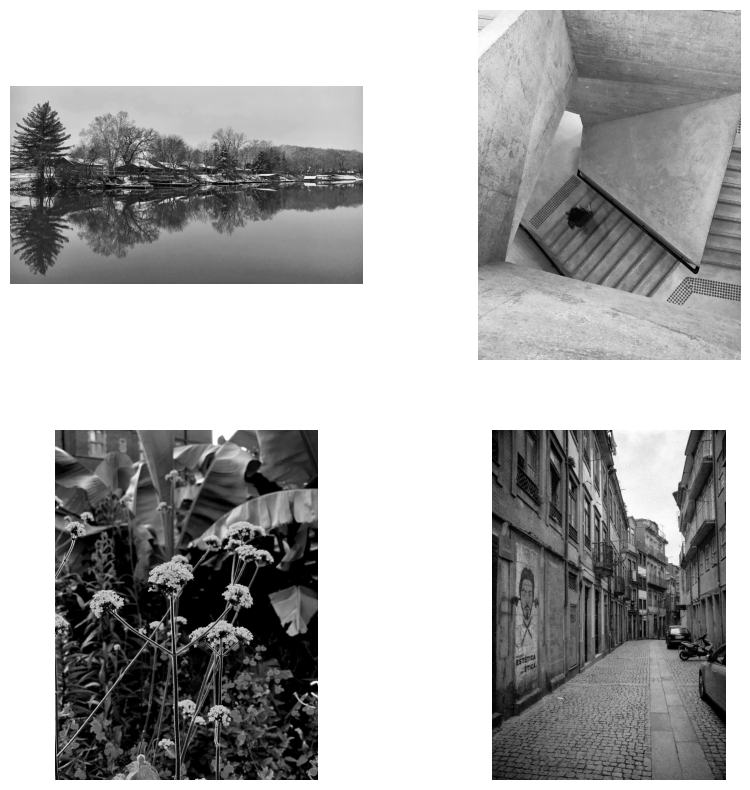

In [3]:
#show images as grid 2 in each row
fig, axs = plt.subplots(len(images)//2, 2, figsize=(10, 10))
for i, img in enumerate(images):
    axs[i//2, i%2].imshow(img, cmap='gray')
    axs[i//2, i%2].axis('off')
plt.show()



### Add Noise

In [4]:
#Add  different  types  of  noise  (e.g.,Gaussian  noise,  Salt-and-Pepper  noise)  with varying intensity levels (low, medium, high)


def add_gaussian_noise(image, mean=0, sigma=25):
    row, col = image.shape
    gauss = np.random.normal(mean, sigma, (row, col))
    noisy = image + gauss
    # Clip the values to be between 0 and 255
    noisy = np.clip(noisy, 0, 255)
    # Convert to unsigned 8-bit integer
    noisy = np.uint8(noisy)

    return noisy

#If amount=0.004 and s_vs_p=0.5, the function will turn approximately 0.4% of the pixels into salt or pepper, with half being white (salt) and half being black (pepper).
def add_salt_pepper_noise(image, amount=0.004):
    row, col = image.shape
    s_vs_p = 0.7  # Salt to pepper ratio
    out = np.copy(image)

    # Salt noise (white pixels)
    num_salt = np.ceil(amount * image.size * s_vs_p)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    out[coords[0], coords[1]] = 255

    # Pepper noise (black pixels)
    num_pepper = np.ceil(amount * image.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    out[coords[0], coords[1]] = 0

    return out


In [5]:
# {0:{gaussian: [], salt_pepper: []}, 1:{gaussian: [], salt_pepper: []}, ...}
images_with_noise = {i: {'gaussian': [], 'salt_pepper': []} for i in range(len(images))}

gaus_values = [50, 150, 300]
salt_pepper_values = [0.1, 0.5, 0.7]

for i, img in enumerate(images):

    for value in gaus_values:
        images_with_noise[i]['gaussian'].append(add_gaussian_noise(img, sigma=value))

    for value in salt_pepper_values:
        images_with_noise[i]['salt_pepper'].append(add_salt_pepper_noise(img, amount=value))

Showing Gaussian noise for image 1:


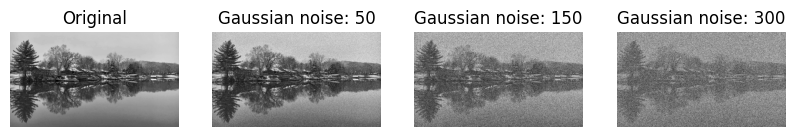

Showing Gaussian noise for image 2:


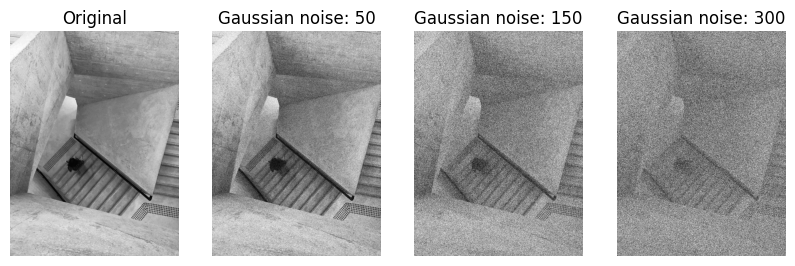

Showing Gaussian noise for image 3:


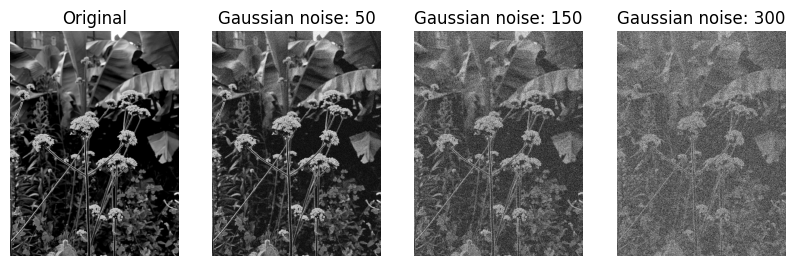

Showing Gaussian noise for image 4:


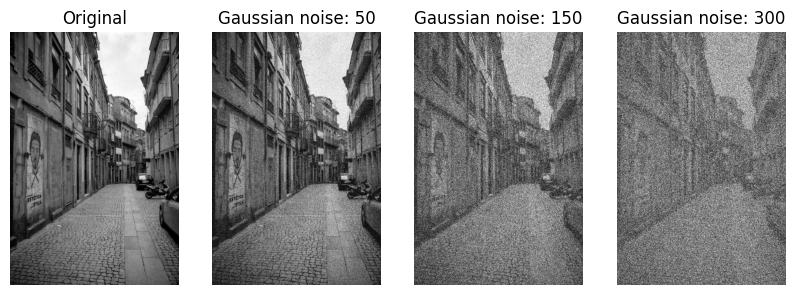

In [6]:

for i in range(len(images)):
    print(f"Showing Gaussian noise for image {i+1}:")
    fig, axs = plt.subplots(1, len(gaus_values)+1, figsize=(10, 10))
    axs[0].imshow(images[i], cmap='gray')
    axs[0].axis('off')
    axs[0].set_title('Original')

    for j, img in enumerate(images_with_noise[i]['gaussian']):
        axs[j+1].imshow(img, cmap='gray')
        axs[j+1].axis('off')
        axs[j+1].set_title(f'Gaussian noise: {gaus_values[j]}')

    plt.show()


Showing salt_pepper noise for image 1:


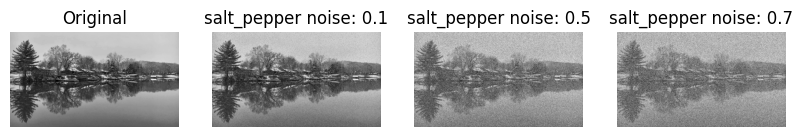

Showing salt_pepper noise for image 2:


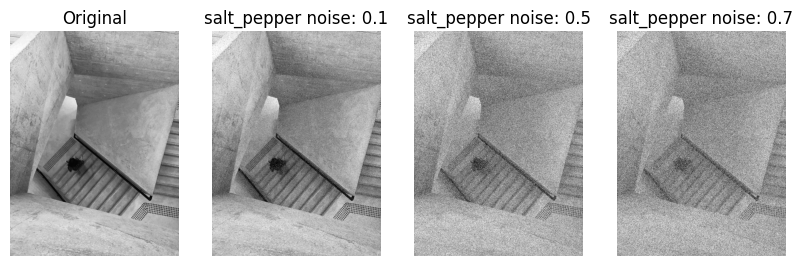

Showing salt_pepper noise for image 3:


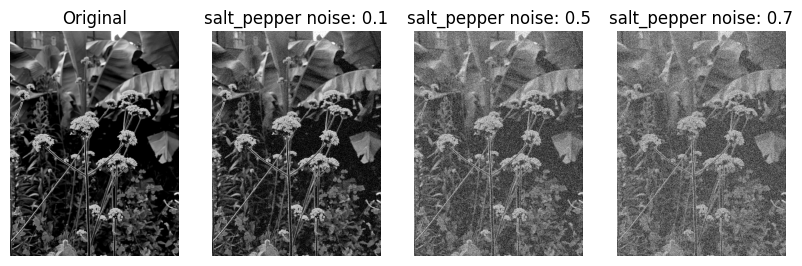

Showing salt_pepper noise for image 4:


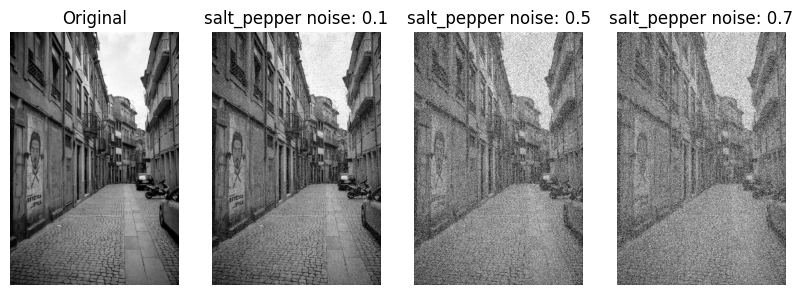

In [7]:

for i in range(len(images)):
    print(f"Showing salt_pepper noise for image {i+1}:")
    fig, axs = plt.subplots(1, len(salt_pepper_values)+1, figsize=(10, 10))
    axs[0].imshow(images[i], cmap='gray')
    axs[0].axis('off')
    axs[0].set_title('Original')

    for j, img in enumerate(images_with_noise[i]['salt_pepper']):
        axs[j+1].imshow(img, cmap='gray')
        axs[j+1].axis('off')
        axs[j+1].set_title(f'salt_pepper noise: {salt_pepper_values[j]}')

    plt.show()


## Simple Filters

In [8]:
kernel_sizes = [3,15, 35]

# kernel_sizes = range(3, 36, 2)

In [9]:
def print_with_border(message):
    border_length = len(message) + 4
    print('*' * border_length)
    print('* ' + message + ' *')
    print('*' * border_length)
    print()

### Box Filter

#### Gaussian Noise

In [10]:

#images_with_box_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_box_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

time_images_with_box_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            start_time = time.time()
            images_with_box_filter_gaussian[i][j].append(cv2.blur(images_with_noise[i]['gaussian'][j], (k, k)))
            time_images_with_box_filter_gaussian[i][j].append((time.time() - start_time)*1000)




{0: 4.614571730295817, 1: 5.759616692860921, 2: 5.053877830505371}


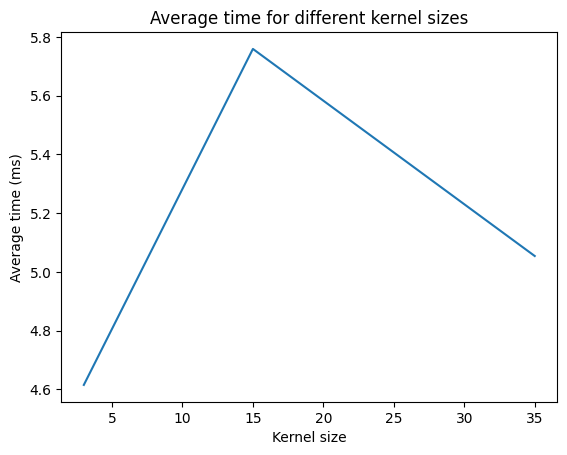

In [11]:


average_time = {i:0 for i in range(len(kernel_sizes))}

for i in range (len(kernel_sizes)):
    for j in range(len(images)):
        for k in range(len(gaus_values)):
            average_time[i] += time_images_with_box_filter_gaussian[j][k][i]



average_time = {i:average_time[i]/(len(images)*len(gaus_values)) for i in range(len(kernel_sizes))}
print(average_time)

# plot
plt.plot(kernel_sizes, list(average_time.values()))
plt.xlabel('Kernel size')
plt.ylabel('Average time (ms)')
plt.title('Average time for different kernel sizes')
plt.show()


***********************************************
* Showing images with box filter for image 1: *
***********************************************


	Showing images with box filter for Gaussian noise 50:


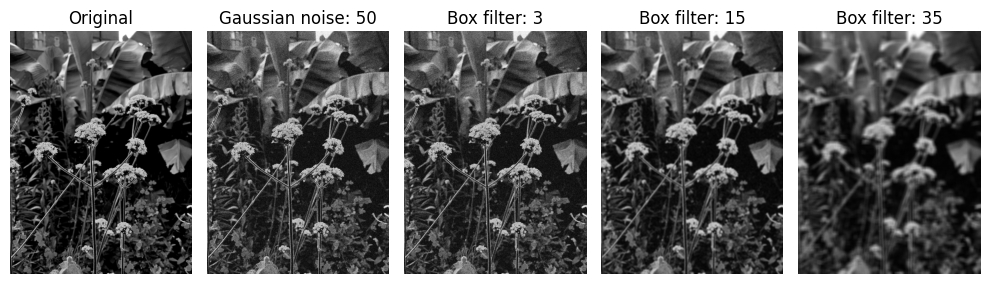


	Showing images with box filter for Gaussian noise 150:


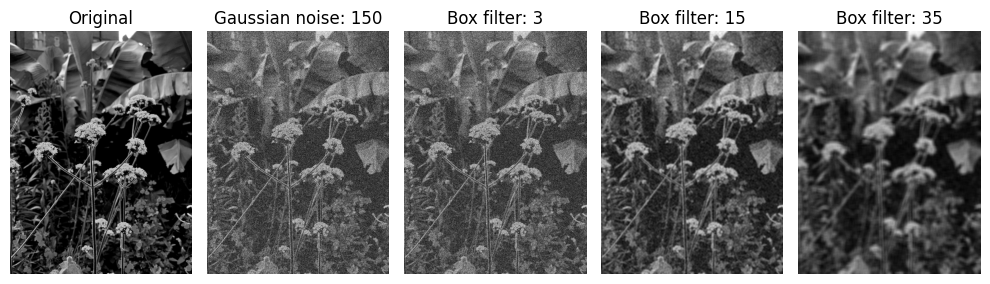


	Showing images with box filter for Gaussian noise 300:


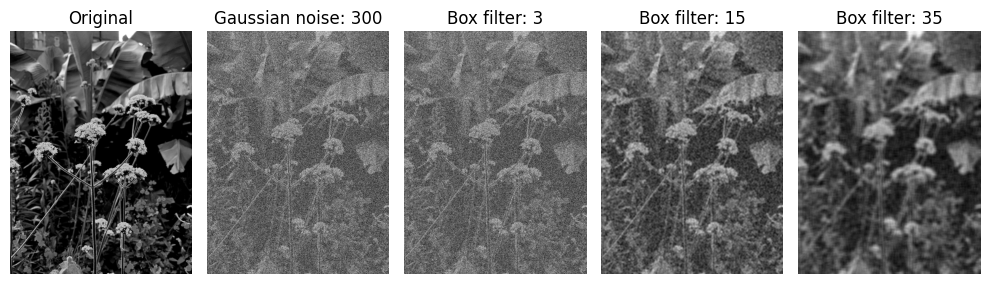

***********************************************
* Showing images with box filter for image 2: *
***********************************************


	Showing images with box filter for Gaussian noise 50:


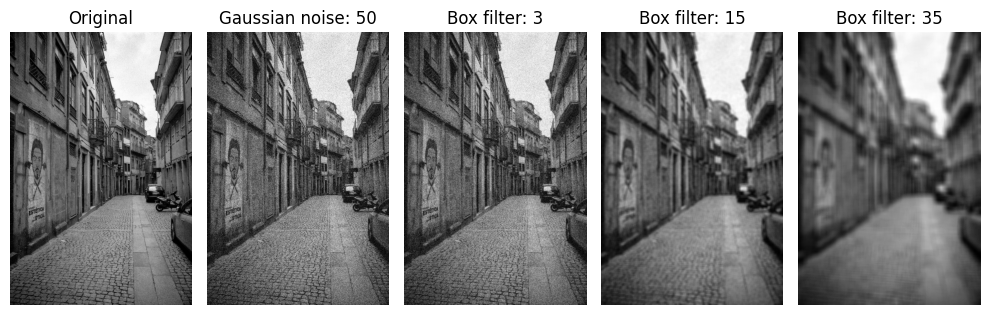


	Showing images with box filter for Gaussian noise 150:


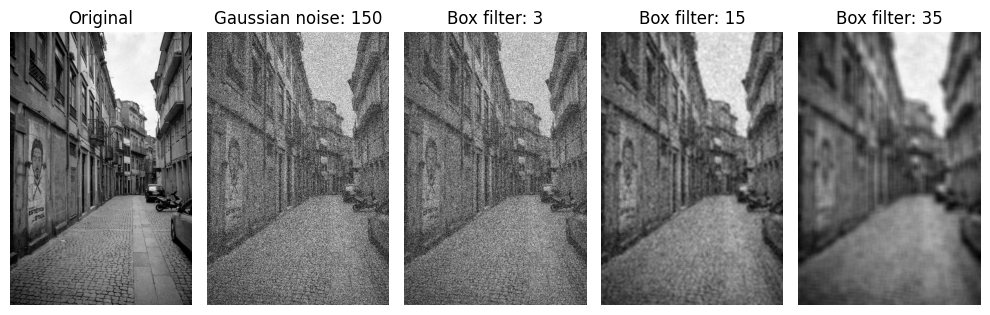


	Showing images with box filter for Gaussian noise 300:


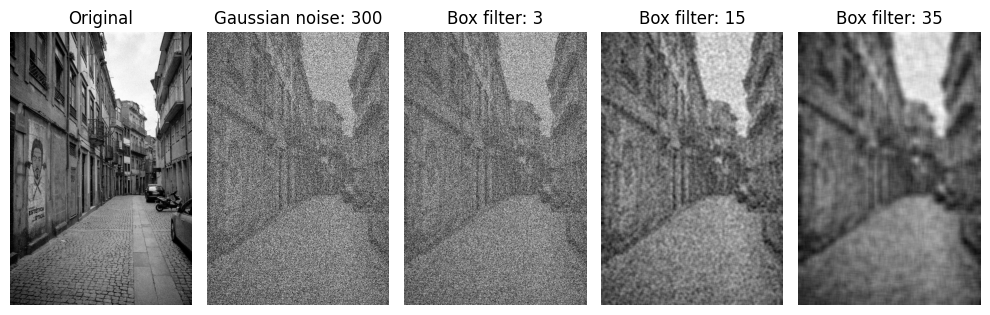

***********************************************
* Showing images with box filter for image 3: *
***********************************************


	Showing images with box filter for Gaussian noise 50:


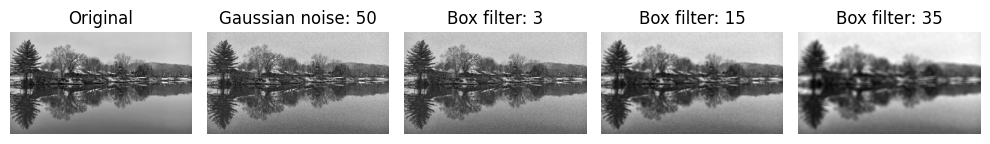


	Showing images with box filter for Gaussian noise 150:


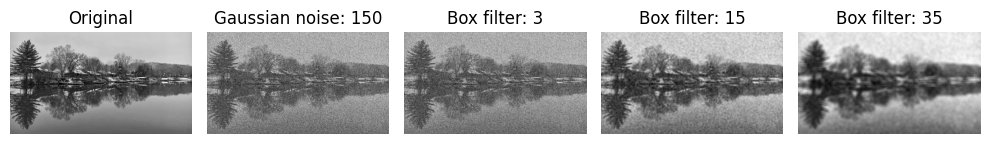


	Showing images with box filter for Gaussian noise 300:


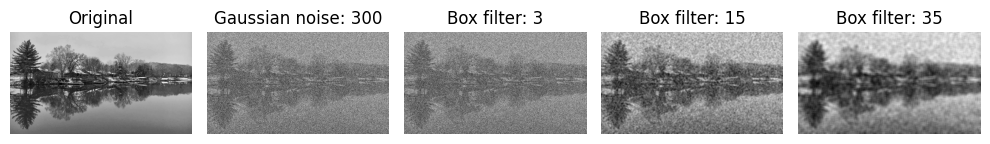

***********************************************
* Showing images with box filter for image 4: *
***********************************************


	Showing images with box filter for Gaussian noise 50:


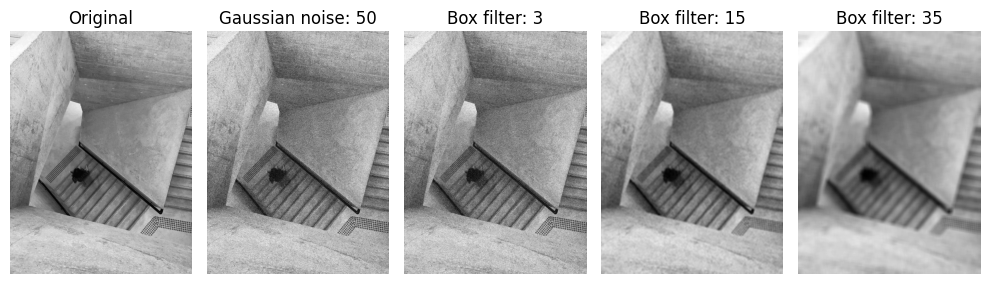


	Showing images with box filter for Gaussian noise 150:


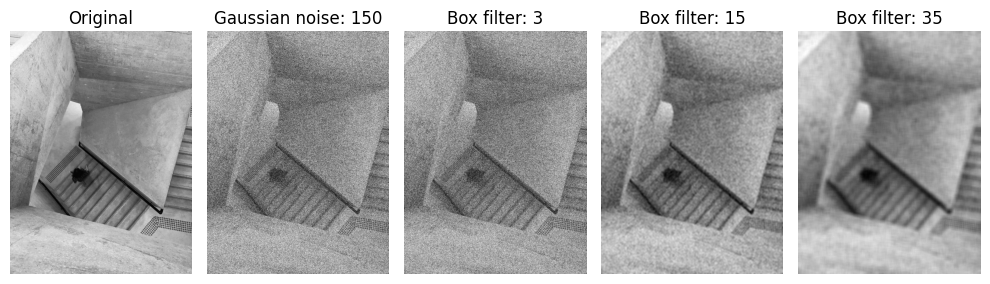


	Showing images with box filter for Gaussian noise 300:


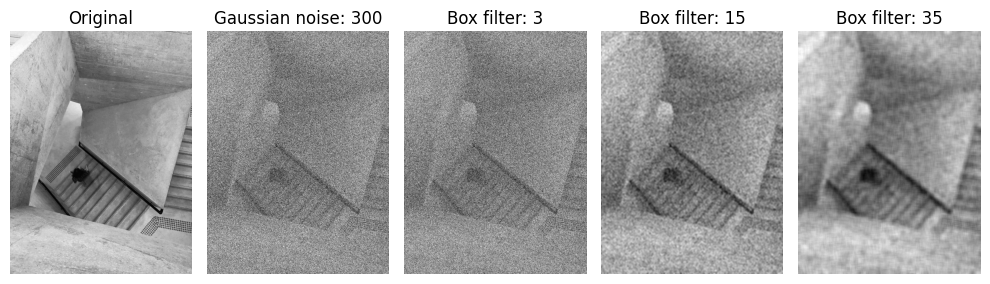

In [12]:
import matplotlib.pyplot as plt


for i in range(len(images)):
    print_with_border(f"Showing images with box filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with box filter for Gaussian noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['gaussian'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Gaussian noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_box_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Box filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





#### Salt_Pepper Noise

In [13]:

#images_with_box_filter_salt_peper = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_box_filter_salt_pepper = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}



for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            images_with_box_filter_salt_pepper[i][j].append(cv2.blur(images_with_noise[i]['salt_pepper'][j], (k, k)))




***********************************************
* Showing images with box filter for image 1: *
***********************************************


	==> Showing images with box filter for salt_pepper noise 0.1:


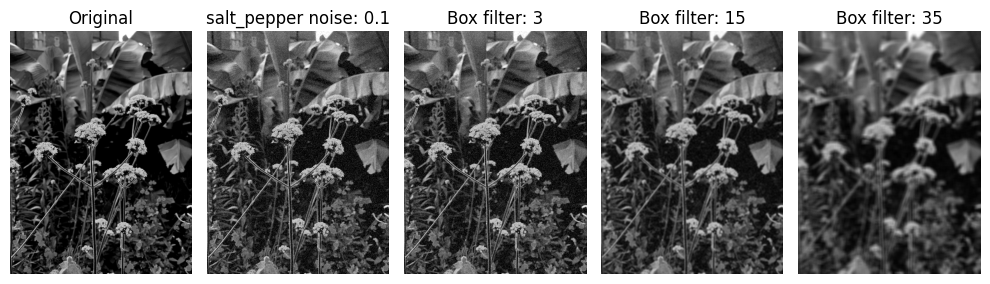


	==> Showing images with box filter for salt_pepper noise 0.5:


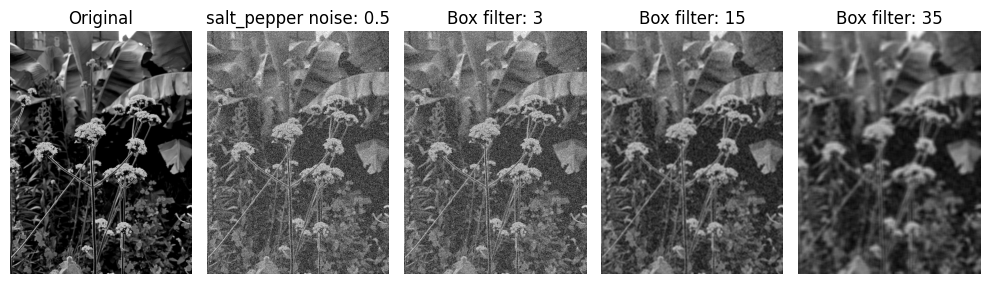


	==> Showing images with box filter for salt_pepper noise 0.7:


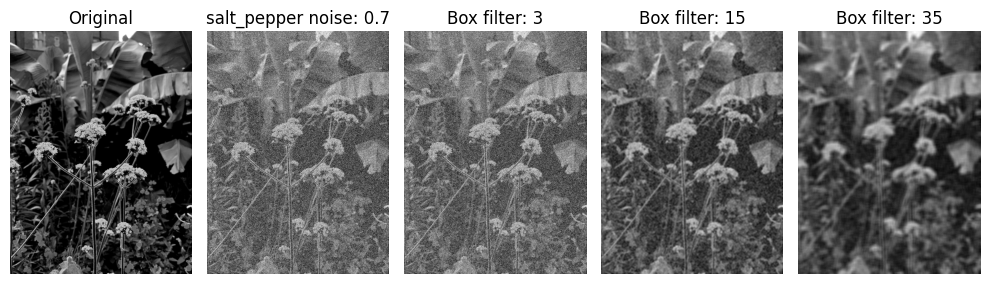

***********************************************
* Showing images with box filter for image 2: *
***********************************************


	==> Showing images with box filter for salt_pepper noise 0.1:


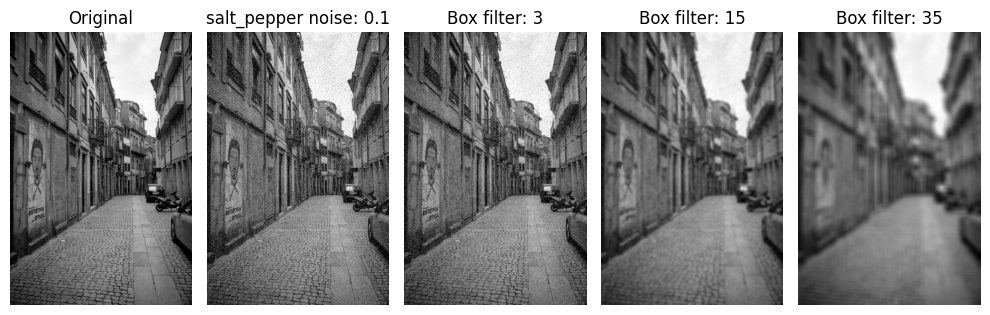


	==> Showing images with box filter for salt_pepper noise 0.5:


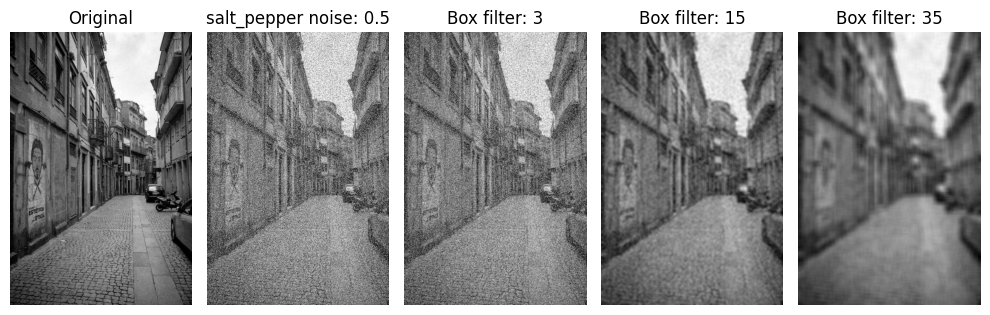


	==> Showing images with box filter for salt_pepper noise 0.7:


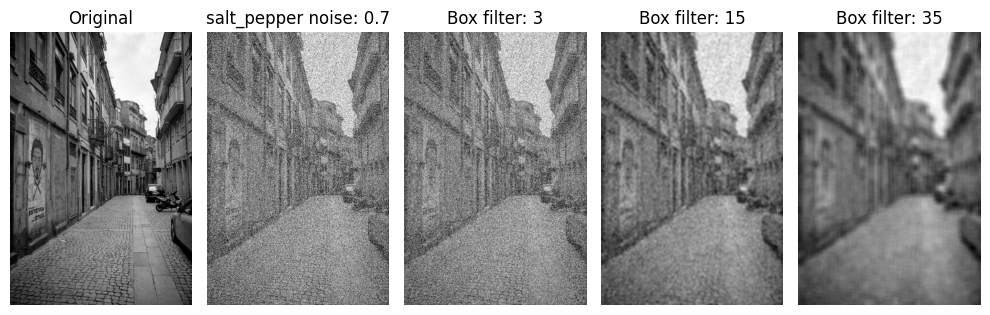

***********************************************
* Showing images with box filter for image 3: *
***********************************************


	==> Showing images with box filter for salt_pepper noise 0.1:


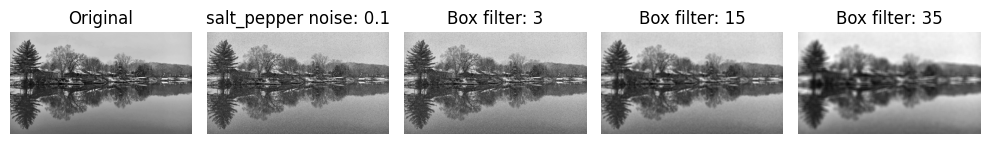


	==> Showing images with box filter for salt_pepper noise 0.5:


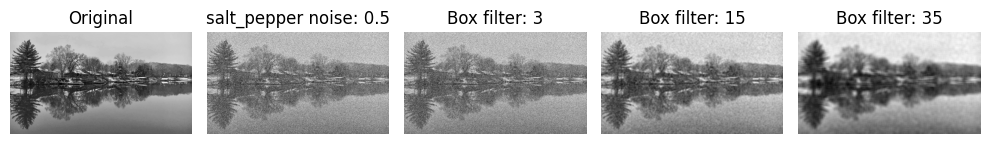


	==> Showing images with box filter for salt_pepper noise 0.7:


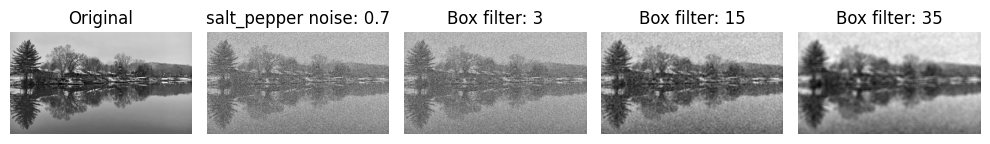

***********************************************
* Showing images with box filter for image 4: *
***********************************************


	==> Showing images with box filter for salt_pepper noise 0.1:


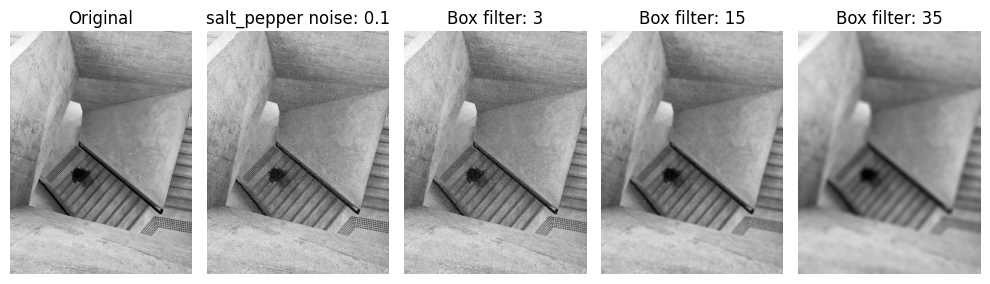


	==> Showing images with box filter for salt_pepper noise 0.5:


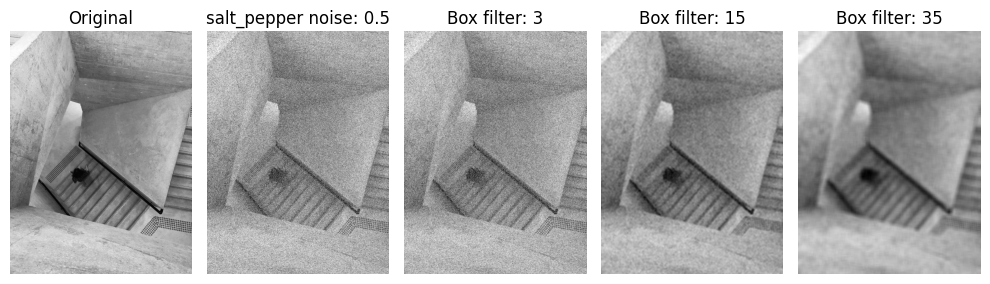


	==> Showing images with box filter for salt_pepper noise 0.7:


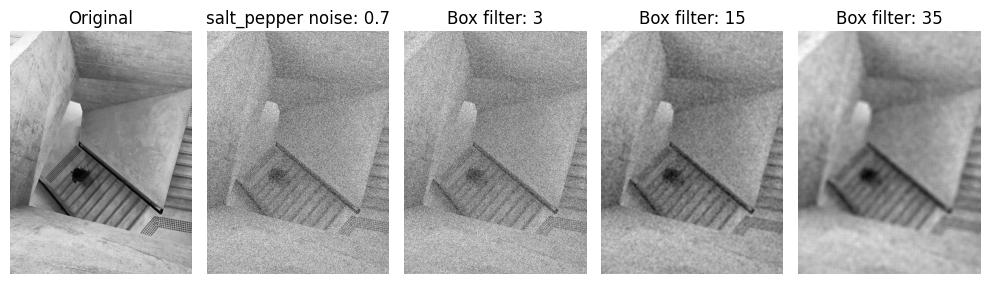

In [14]:
import matplotlib.pyplot as plt


for i in range(len(images)):
    print_with_border(f"Showing images with box filter for image {i + 1}:")

    for j in range(len(salt_pepper_values)):
        print(f"\n\t==> Showing images with box filter for salt_pepper noise {salt_pepper_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['salt_pepper'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'salt_pepper noise: {salt_pepper_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_box_filter_salt_pepper[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Box filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()



### Gaussian Filter

#### Gaussian Noise

In [15]:

#images_with_gaussian_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_gaussian_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

images_with_gaussian_filter_gaussian

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            images_with_gaussian_filter_gaussian[i][j].append(cv2.GaussianBlur(images_with_noise[i]['gaussian'][j], (k, k),0))




****************************************************
* Showing images with gaussian filter for image 1: *
****************************************************


	Showing images with gaussian filter for Gaussian noise 50:


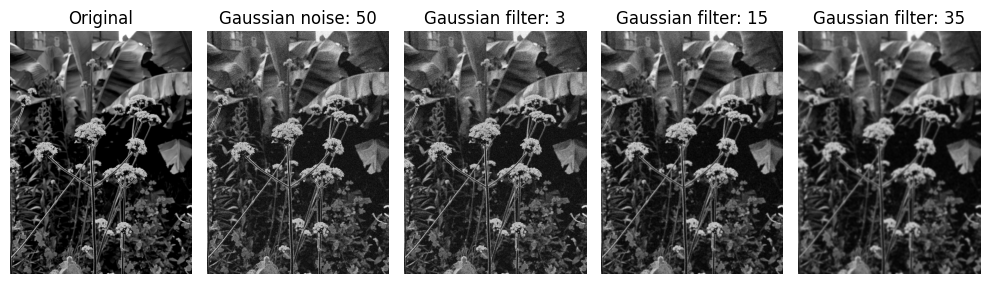


	Showing images with gaussian filter for Gaussian noise 150:


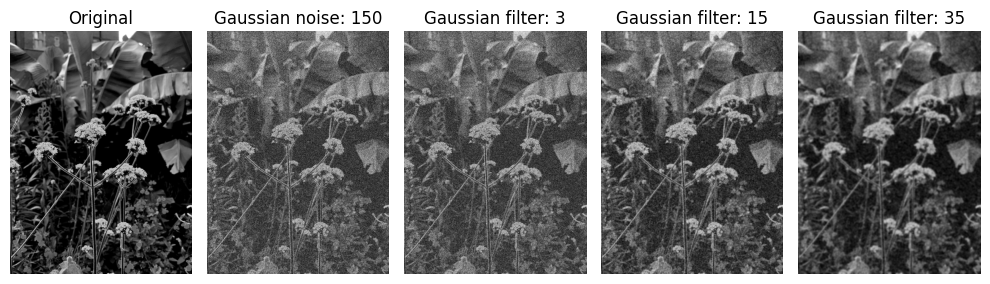


	Showing images with gaussian filter for Gaussian noise 300:


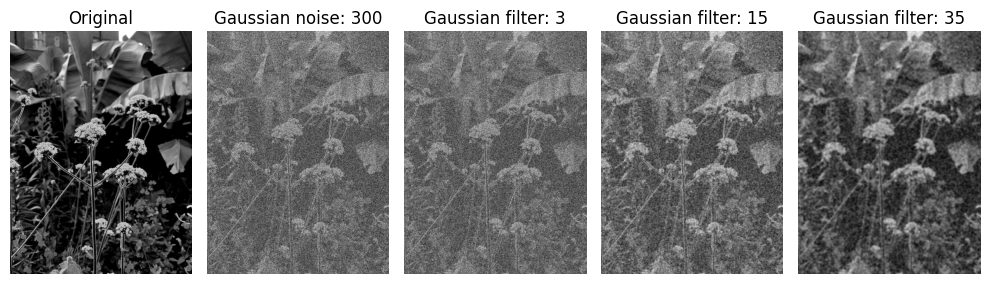

****************************************************
* Showing images with gaussian filter for image 2: *
****************************************************


	Showing images with gaussian filter for Gaussian noise 50:


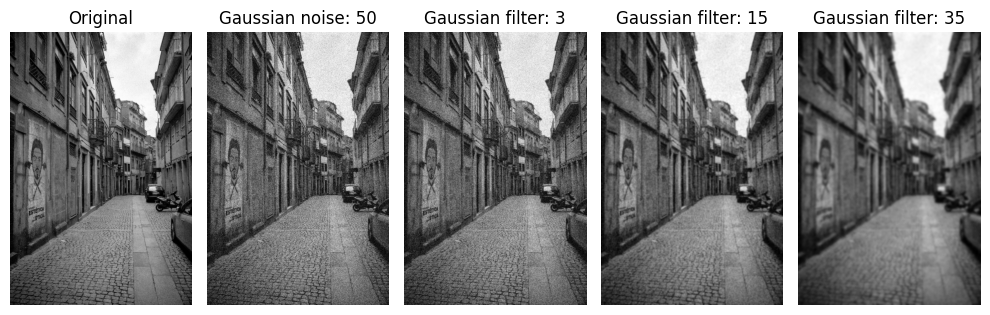


	Showing images with gaussian filter for Gaussian noise 150:


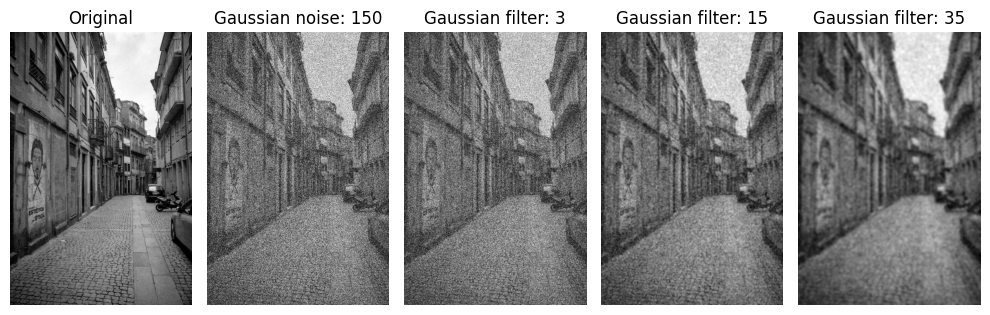


	Showing images with gaussian filter for Gaussian noise 300:


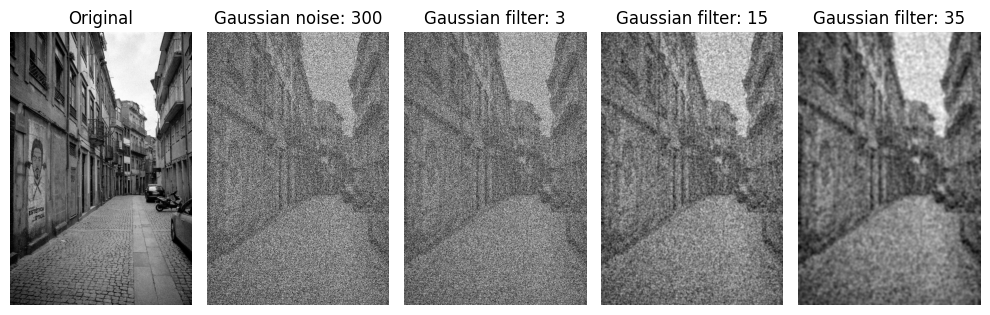

****************************************************
* Showing images with gaussian filter for image 3: *
****************************************************


	Showing images with gaussian filter for Gaussian noise 50:


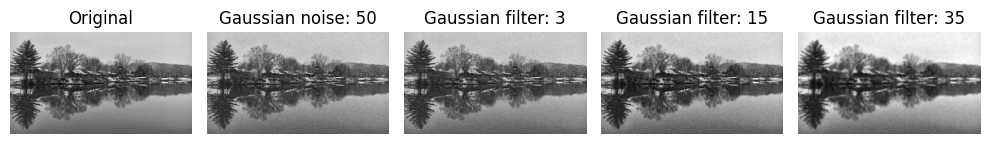


	Showing images with gaussian filter for Gaussian noise 150:


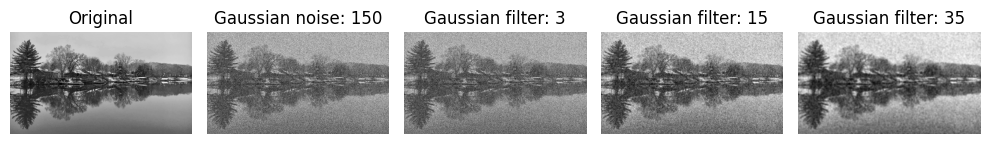


	Showing images with gaussian filter for Gaussian noise 300:


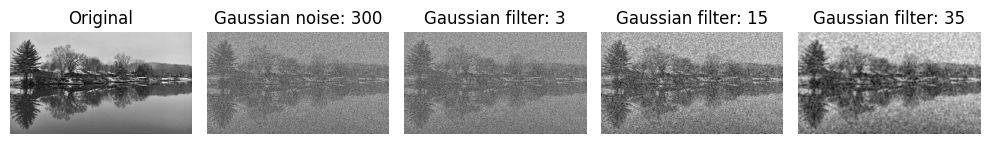

****************************************************
* Showing images with gaussian filter for image 4: *
****************************************************


	Showing images with gaussian filter for Gaussian noise 50:


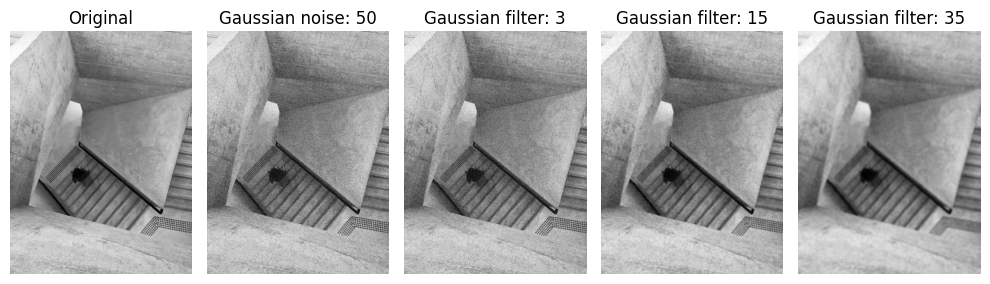


	Showing images with gaussian filter for Gaussian noise 150:


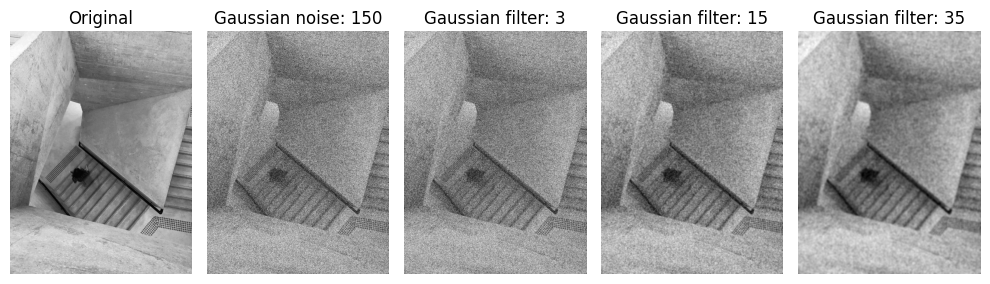


	Showing images with gaussian filter for Gaussian noise 300:


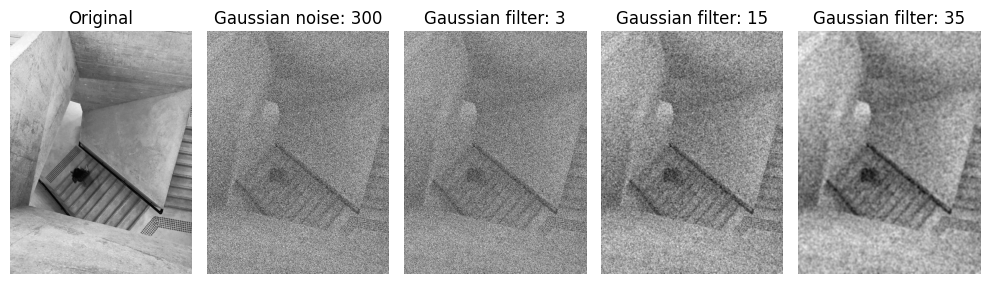

In [16]:



for i in range(len(images)):
    print_with_border(f"Showing images with gaussian filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with gaussian filter for Gaussian noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['gaussian'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Gaussian noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_gaussian_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Gaussian filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





#### Salt_Pepper Noise

In [17]:

#images_with_gaussian_filter_salt_pepper = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_gaussian_filter_salt_pepper = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

images_with_gaussian_filter_gaussian

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            images_with_gaussian_filter_salt_pepper[i][j].append(cv2.GaussianBlur(images_with_noise[i]['salt_pepper'][j], (k, k),0))




****************************************************
* Showing images with gaussian filter for image 1: *
****************************************************


	Showing images with gaussian filter for salt_pepper noise 0.1:


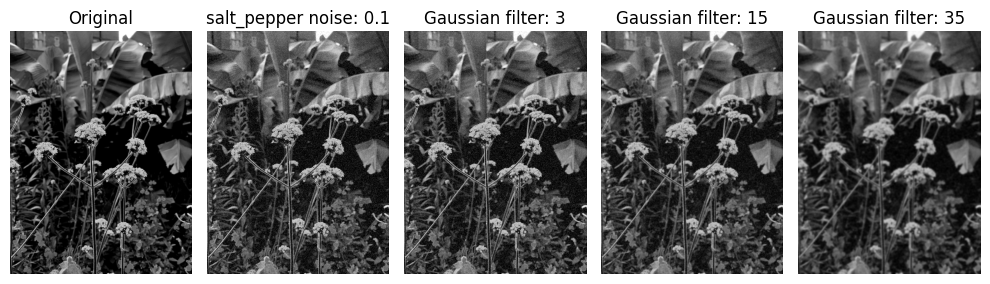


	Showing images with gaussian filter for salt_pepper noise 0.5:


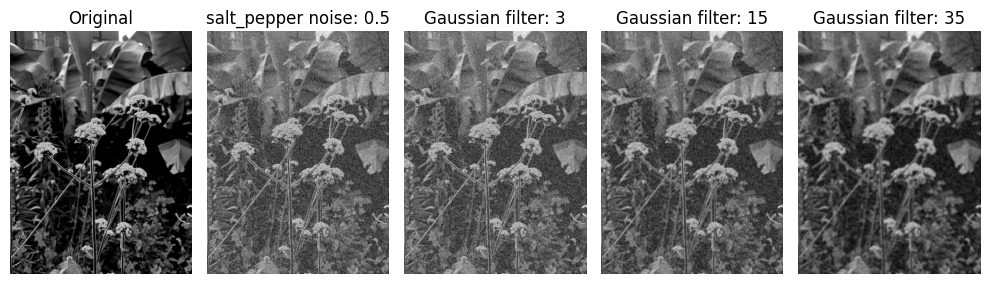


	Showing images with gaussian filter for salt_pepper noise 0.7:


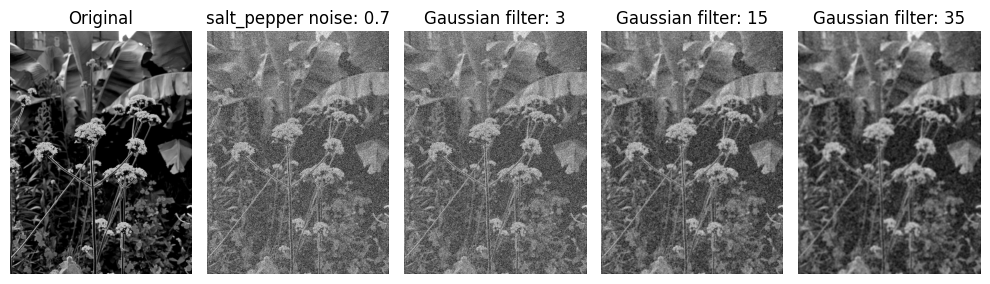

****************************************************
* Showing images with gaussian filter for image 2: *
****************************************************


	Showing images with gaussian filter for salt_pepper noise 0.1:


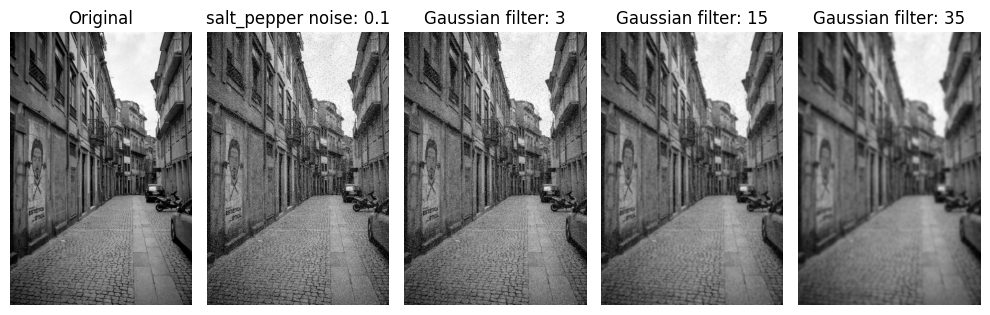


	Showing images with gaussian filter for salt_pepper noise 0.5:


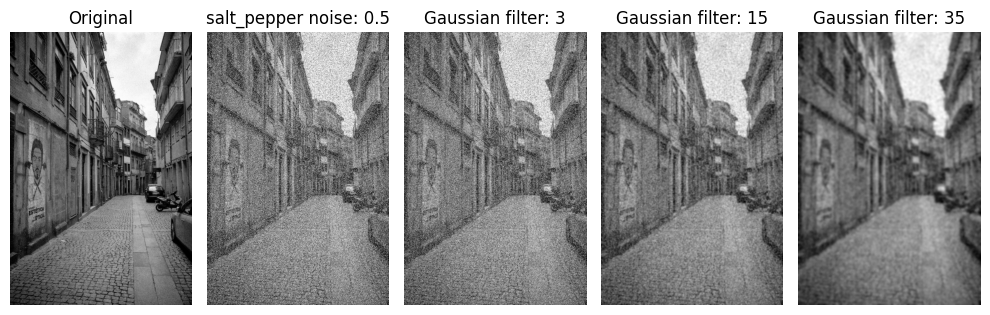


	Showing images with gaussian filter for salt_pepper noise 0.7:


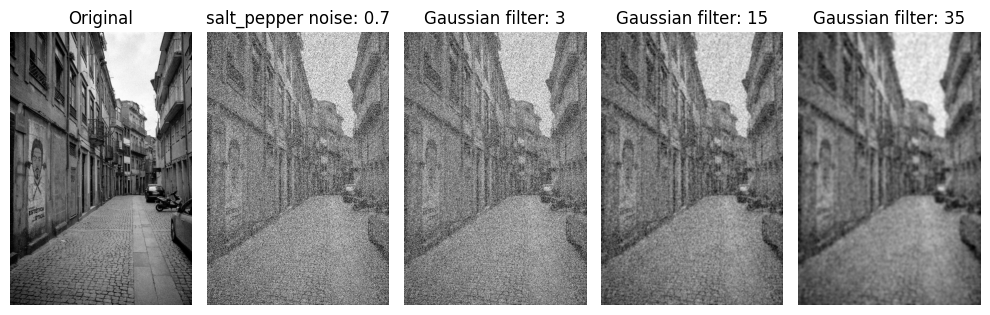

****************************************************
* Showing images with gaussian filter for image 3: *
****************************************************


	Showing images with gaussian filter for salt_pepper noise 0.1:


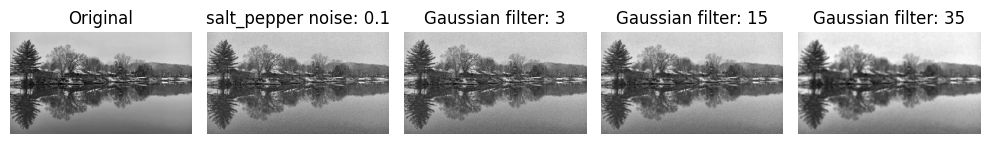


	Showing images with gaussian filter for salt_pepper noise 0.5:


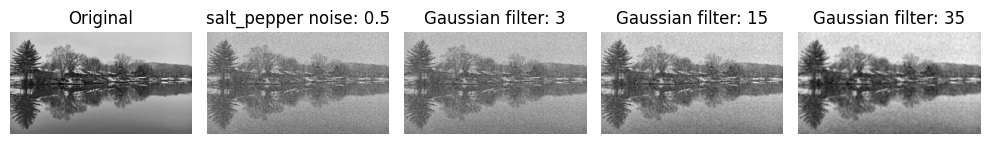


	Showing images with gaussian filter for salt_pepper noise 0.7:


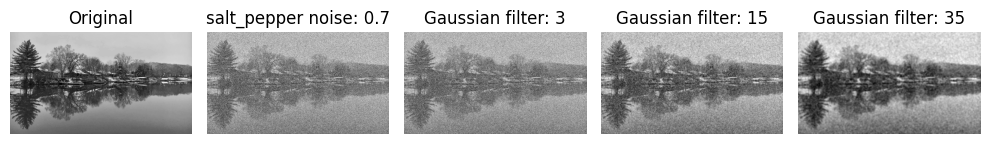

****************************************************
* Showing images with gaussian filter for image 4: *
****************************************************


	Showing images with gaussian filter for salt_pepper noise 0.1:


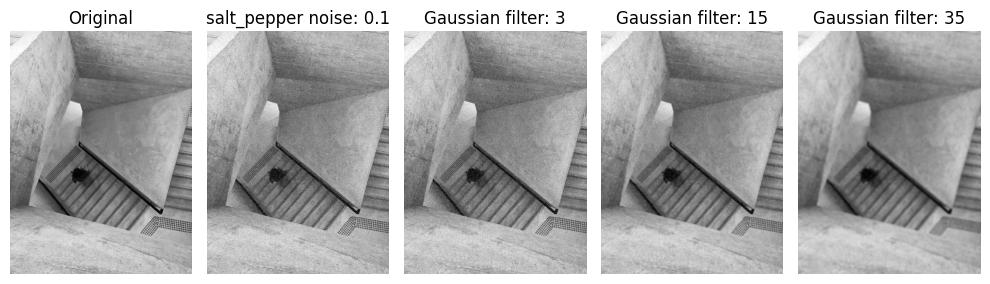


	Showing images with gaussian filter for salt_pepper noise 0.5:


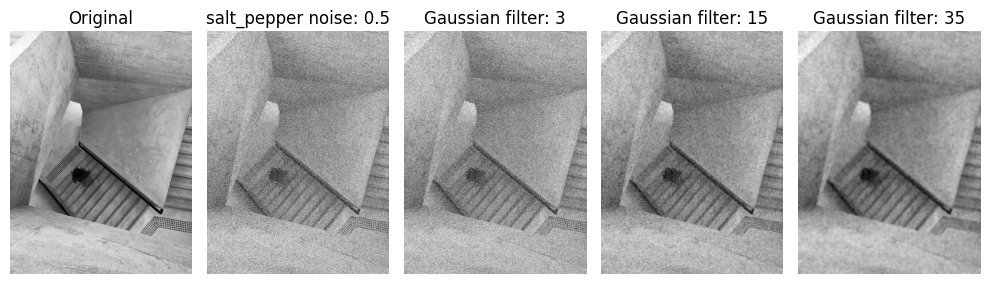


	Showing images with gaussian filter for salt_pepper noise 0.7:


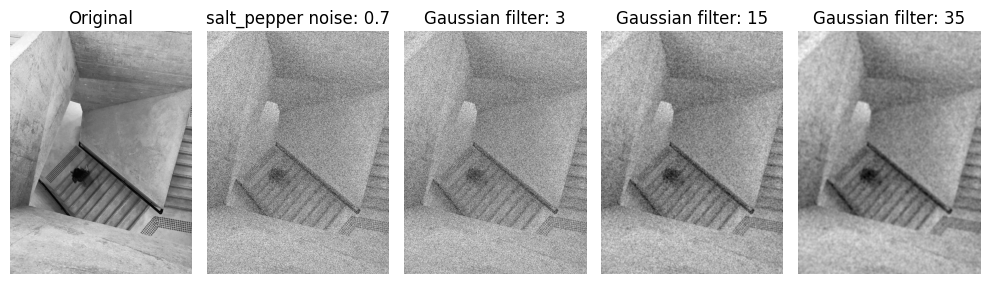

In [18]:



for i in range(len(images)):
    print_with_border(f"Showing images with gaussian filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with gaussian filter for salt_pepper noise {salt_pepper_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['salt_pepper'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'salt_pepper noise: {salt_pepper_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_gaussian_filter_salt_pepper[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Gaussian filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





### Median Filter

#### Gaussian Noise

In [19]:

#images_with_median_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_median_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

images_with_median_filter_gaussian

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            # here kernel as k
            images_with_median_filter_gaussian[i][j].append(cv2.medianBlur(images_with_noise[i]['gaussian'][j],  k))




**************************************************
* Showing images with Median filter for image 1: *
**************************************************


	Showing images with median filter for Gaussian noise 50:


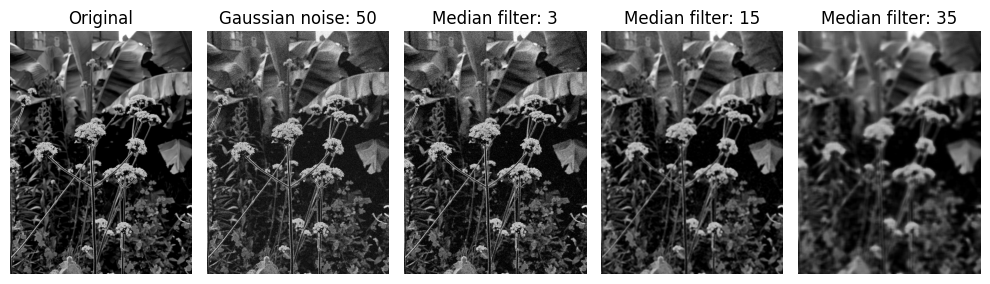


	Showing images with median filter for Gaussian noise 150:


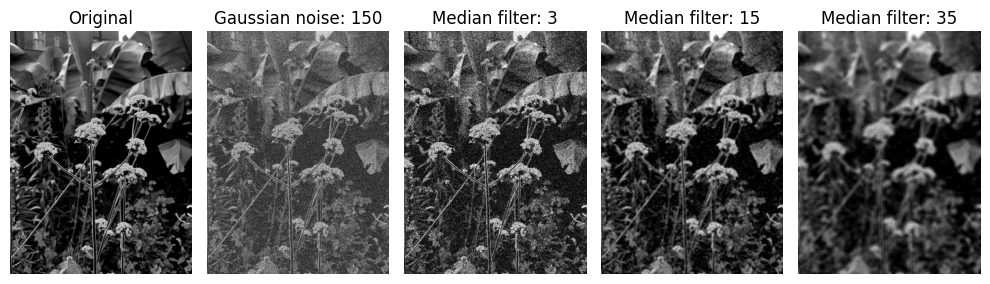


	Showing images with median filter for Gaussian noise 300:


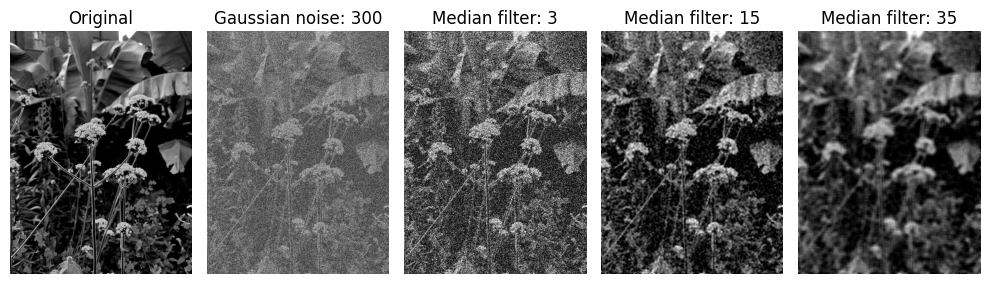

**************************************************
* Showing images with Median filter for image 2: *
**************************************************


	Showing images with median filter for Gaussian noise 50:


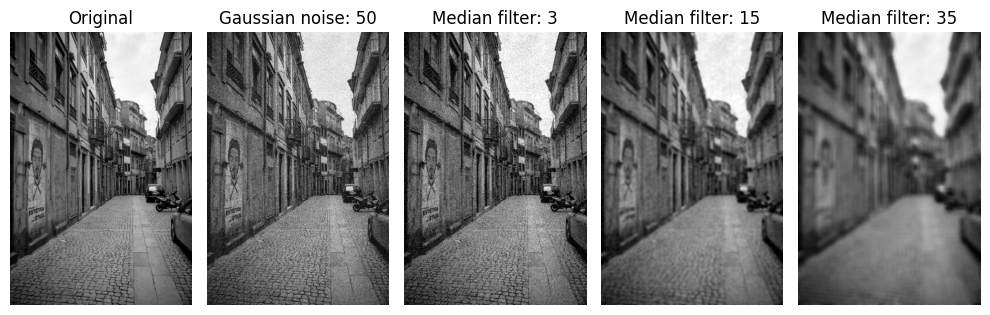


	Showing images with median filter for Gaussian noise 150:


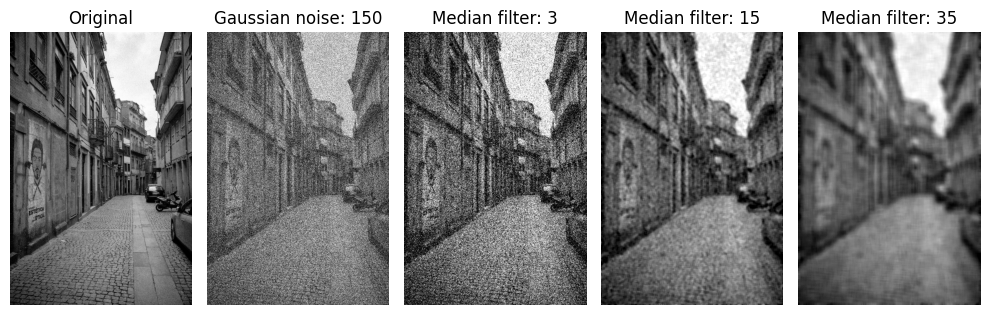


	Showing images with median filter for Gaussian noise 300:


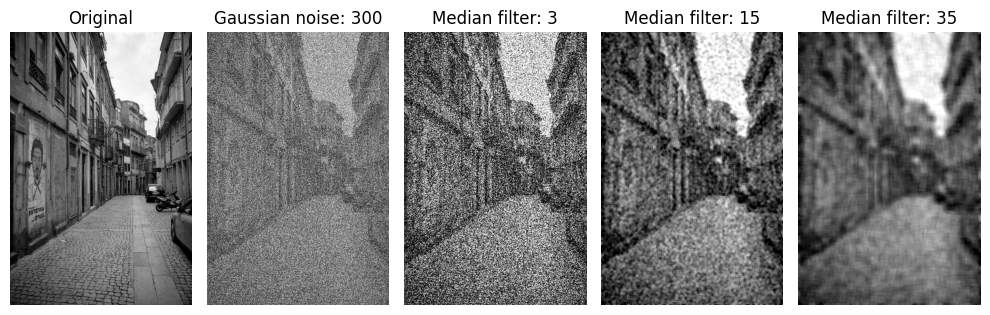

**************************************************
* Showing images with Median filter for image 3: *
**************************************************


	Showing images with median filter for Gaussian noise 50:


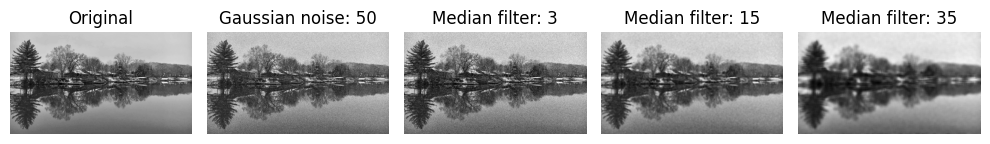


	Showing images with median filter for Gaussian noise 150:


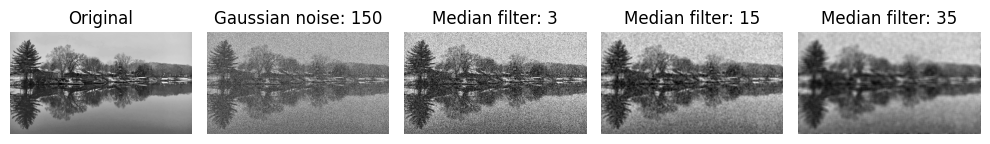


	Showing images with median filter for Gaussian noise 300:


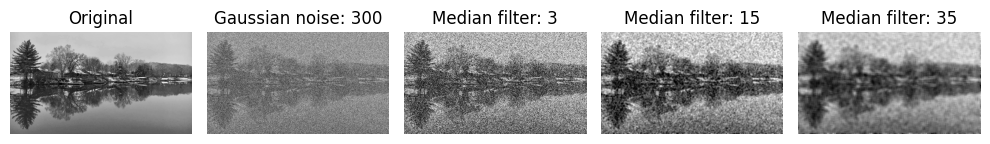

**************************************************
* Showing images with Median filter for image 4: *
**************************************************


	Showing images with median filter for Gaussian noise 50:


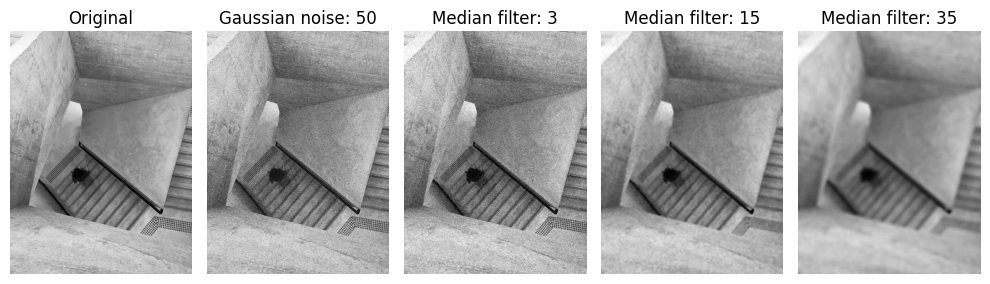


	Showing images with median filter for Gaussian noise 150:


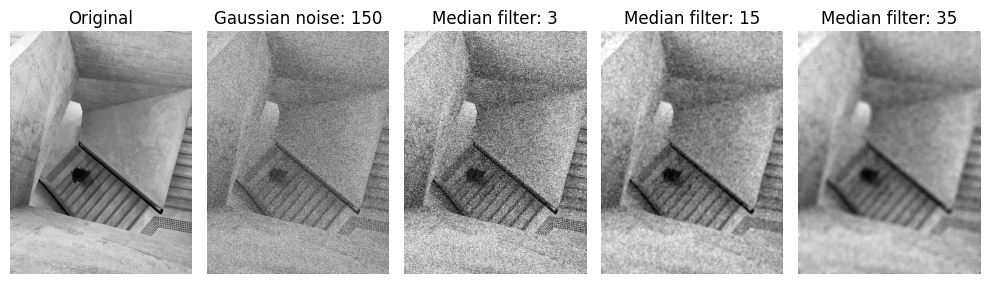


	Showing images with median filter for Gaussian noise 300:


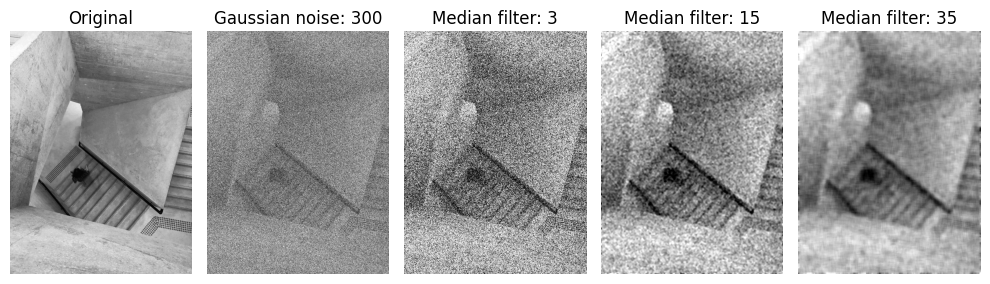

In [20]:



for i in range(len(images)):
    print_with_border(f"Showing images with Median filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with median filter for Gaussian noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['gaussian'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Gaussian noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_median_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Median filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





#### Salt_Pepper Noise

In [21]:

#images_with_median_filter_salt_pepper = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_median_filter_salt_pepper = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

images_with_median_filter_salt_pepper

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            # here kernel as k
            images_with_median_filter_salt_pepper[i][j].append(cv2.medianBlur(images_with_noise[i]['salt_pepper'][j],  k))




**************************************************
* Showing images with Median filter for image 1: *
**************************************************


	Showing images with median filter for Salt_Pepper noise 50:


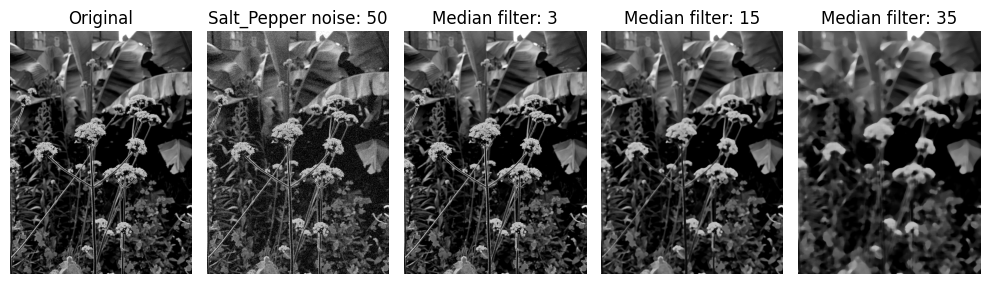


	Showing images with median filter for Salt_Pepper noise 150:


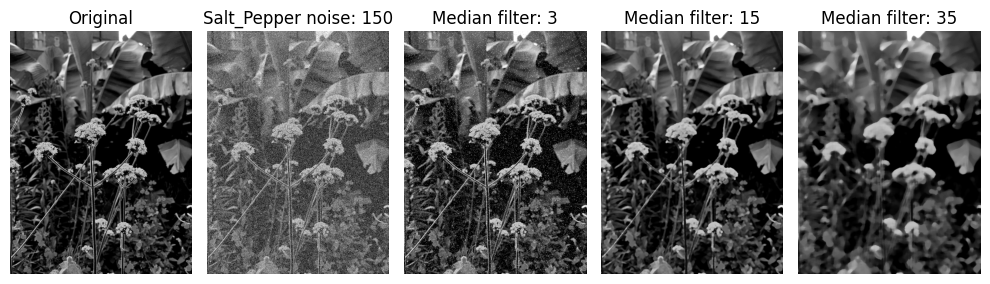


	Showing images with median filter for Salt_Pepper noise 300:


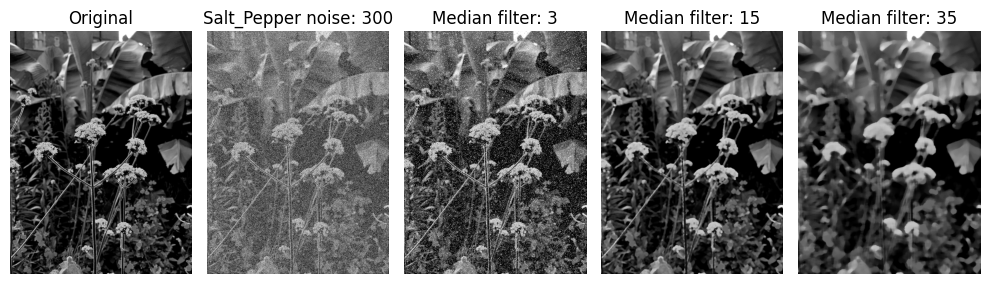

**************************************************
* Showing images with Median filter for image 2: *
**************************************************


	Showing images with median filter for Salt_Pepper noise 50:


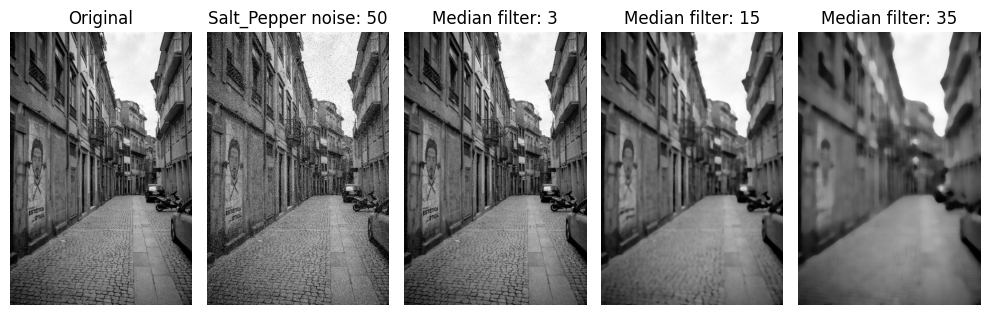


	Showing images with median filter for Salt_Pepper noise 150:


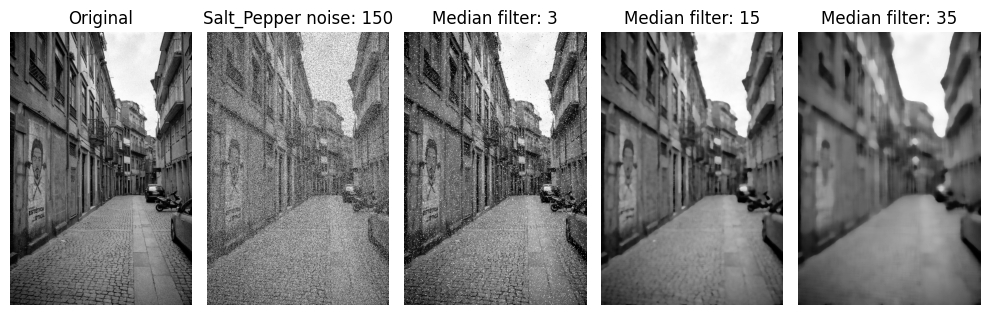


	Showing images with median filter for Salt_Pepper noise 300:


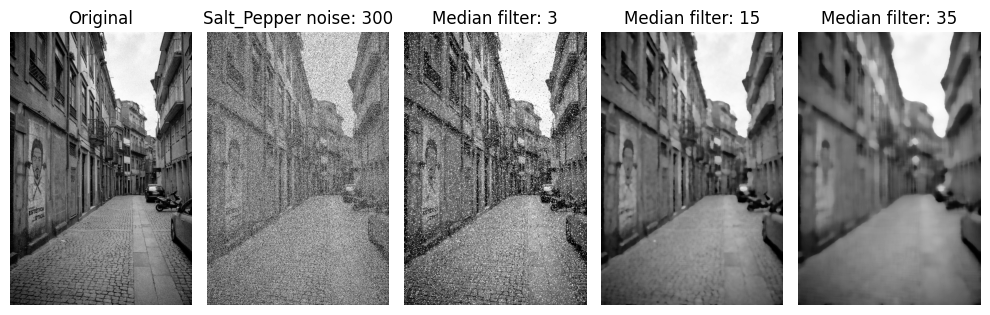

**************************************************
* Showing images with Median filter for image 3: *
**************************************************


	Showing images with median filter for Salt_Pepper noise 50:


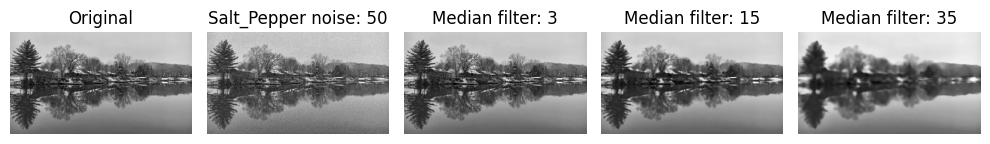


	Showing images with median filter for Salt_Pepper noise 150:


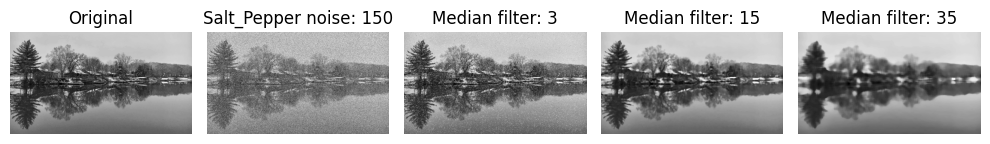


	Showing images with median filter for Salt_Pepper noise 300:


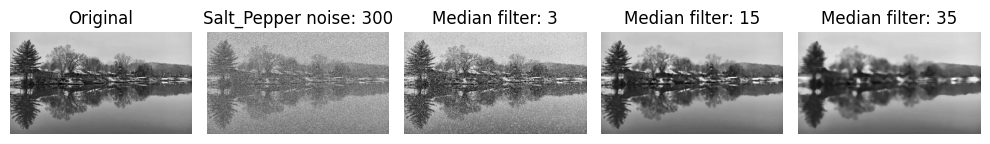

**************************************************
* Showing images with Median filter for image 4: *
**************************************************


	Showing images with median filter for Salt_Pepper noise 50:


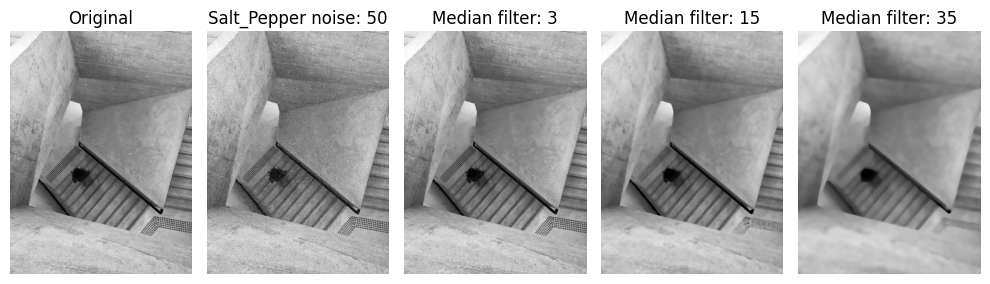


	Showing images with median filter for Salt_Pepper noise 150:


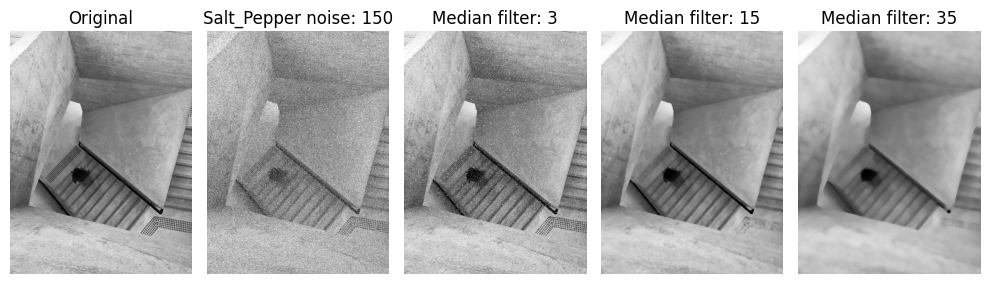


	Showing images with median filter for Salt_Pepper noise 300:


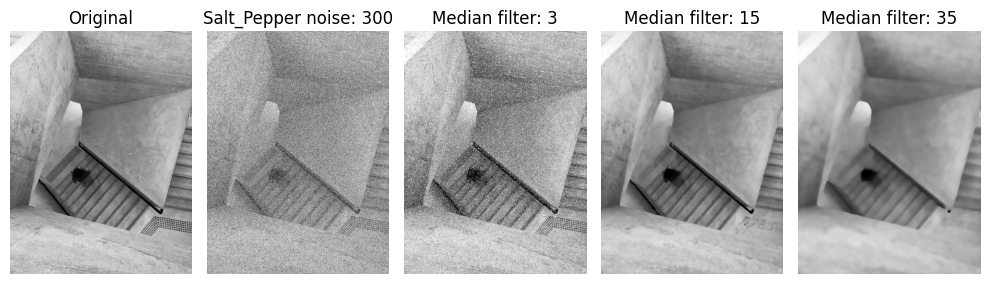

In [22]:



for i in range(len(images)):
    print_with_border(f"Showing images with Median filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with median filter for Salt_Pepper noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['salt_pepper'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Salt_Pepper noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_median_filter_salt_pepper[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Median filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





## Advanced filters

### Adaptive median filter

https://www.irjet.net/archives/V6/i10/IRJET-V6I10148.pdf

In [33]:

def adaptiveMedianFilter(img, max_kernel_size=7):
    """
    Apply adaptive median filtering to an image.

    Parameters:
    img (numpy.ndarray): Input grayscale image (2D array).
    max_kernel_size (int): Maximum allowed kernel size for the filter. Default is 7.

    Returns:
    numpy.ndarray: Filtered image with noise reduced using adaptive median filtering.
    """

    def getMedianValue(window) -> int:
        """
        Calculate the median value of a window.

        Parameters:
        window (numpy.ndarray): 2D array (window) from which the median is to be calculated.

        Returns:
        int: Median value of the window.
        """
        # Flatten and sort the window to compute the median
        window = np.sort(window, axis=None)

        # If the number of elements is even, return the average of the middle two elements
        if window.size % 2 == 0:
            return int((window[window.size // 2 - 1].astype(np.int32) + window[window.size // 2].astype(np.int32)) / 2)
        else:
            return window[window.size // 2]

    def adaptiveMedianFilterRec(img, x, y, kernel_size, max_kernel_size):
        """
        Apply the adaptive median filter recursively at a specific pixel location.

        Parameters:
        img (numpy.ndarray): Input image.
        x (int): x-coordinate (row index) of the current pixel.
        y (int): y-coordinate (column index) of the current pixel.
        kernel_size (int): Current kernel size being applied.
        max_kernel_size (int): Maximum allowed kernel size.

        Returns:
        int: Filtered pixel value.
        """
        half_size = kernel_size // 2
        x_min = max(x - half_size, 0)
        x_max = min(x + half_size + 1, img.shape[0])
        y_min = max(y - half_size, 0)
        y_max = min(y + half_size + 1, img.shape[1])

        # Convert the window to a higher precision (int32) to avoid overflow
        window = img[x_min:x_max, y_min:y_max].astype(np.int32)

        # Find the minimum, maximum, and median values in the window
        z_min = np.min(window)
        z_max = np.max(window)
        z_med = getMedianValue(window)

        # Step A: Check the difference between the median and min/max values
        A1 = z_med - z_min
        A2 = z_med - z_max

        # If the median is in between the min and max values, move to Step B
        if A1 > 0 and A2 < 0:
            B1 = img[x, y].astype(np.int32) - z_min
            B2 = img[x, y].astype(np.int32) - z_max

            # If the current pixel is between the min and max, keep it unchanged
            if B1 > 0 and B2 < 0:
                return img[x, y]
            else:
                # Otherwise, replace it with the median value
                return z_med
        # If the median is not suitable, increase the kernel size and try again (if within limit)
        elif kernel_size < max_kernel_size:
            # Recursive call with increased kernel size
            return adaptiveMedianFilterRec(
                img=img,
                x=x,
                y=y,
                kernel_size=kernel_size + 2,
                max_kernel_size=max_kernel_size
            )
        else:
            # If the max kernel size is reached, use the median value
            return z_med

    # Create an empty image to store the filtered result
    img_filtered = np.zeros_like(img)

    # Loop over every pixel in the image
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            # Apply the adaptive median filter recursively for each pixel
            img_filtered[i, j] = adaptiveMedianFilterRec(
                img=img,
                x=i,
                y=j,
                kernel_size=3,   # Initial kernel size starts from 3x3
                max_kernel_size=max_kernel_size
            )

    return img_filtered


# def adaptiveMedianFilter(img, max_kernel_size=7):
#     """
#     Apply adaptive median filtering to an image (iterative version).

#     Parameters:
#     img (numpy.ndarray): Input grayscale image (2D array).
#     max_kernel_size (int): Maximum allowed kernel size for the filter. Default is 7.

#     Returns:
#     numpy.ndarray: Filtered image with noise reduced using adaptive median filtering.
#     """

#     def getMedianValue(window) -> int:
#         """
#         Calculate the median value of a window.

#         Parameters:
#         window (numpy.ndarray): 2D array (window) from which the median is to be calculated.

#         Returns:
#         int: Median value of the window.
#         """
#         # Sort the window and find the median
#         window = np.sort(window, axis=None)
#         # If the window size is even, take the average of the two middle values
#         if window.size % 2 == 0:
#             return int((window[window.size // 2 - 1] + window[window.size // 2]) / 2)
#         else:
#             return window[window.size // 2]

#     # Create an empty array to store the filtered image
#     img_filtered = np.zeros_like(img, dtype=np.uint8)

#     # Iterate over every pixel in the image
#     for i in range(img.shape[0]):
#         for j in range(img.shape[1]):
#             kernel_size = 3  # Start with the smallest kernel size (3x3)

#             # Incrementally increase the kernel size until the maximum is reached
#             while kernel_size <= max_kernel_size:
#                 half_size = kernel_size // 2

#                 # Define the window boundaries, ensuring we don't exceed image borders
#                 x_min = max(i - half_size, 0)
#                 x_max = min(i + half_size + 1, img.shape[0])
#                 y_min = max(j - half_size, 0)
#                 y_max = min(j + half_size + 1, img.shape[1])

#                 # Extract the window of pixels around the current pixel
#                 window = img[x_min:x_max, y_min:y_max].astype(np.int32)

#                 # Get the minimum, maximum, and median of the window
#                 z_min = np.min(window)
#                 z_max = np.max(window)
#                 z_med = getMedianValue(window)

#                 # Check if the median value satisfies the adaptive filter condition
#                 A1 = z_med - z_min
#                 A2 = z_med - z_max

#                 if A1 > 0 and A2 < 0:
#                     # Check if the current pixel value satisfies the condition
#                     B1 = img[i, j].astype(np.int32) - z_min
#                     B2 = img[i, j].astype(np.int32) - z_max

#                     if B1 > 0 and B2 < 0:
#                         # If the pixel value satisfies the condition, leave it unchanged
#                         img_filtered[i, j] = img[i, j]
#                     else:
#                         # Otherwise, replace it with the median value
#                         img_filtered[i, j] = z_med
#                     # Break the loop once the condition is met
#                     break
#                 else:
#                     # If the median condition is not met, increase the kernel size
#                     kernel_size += 2

#             # If the maximum kernel size is reached, use the median value
#             if kernel_size > max_kernel_size:
#                 img_filtered[i, j] = z_med

#     # Return the filtered image
#     return img_filtered


In [40]:

#images_with_box_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_AdaptiveMedian_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

# time_images_with_box_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            # start_time = time.time()
            # images_with_box_filter_gaussian[i][j].append(cv2.blur(images_with_noise[i]['gaussian'][j], (k, k)))
            images_with_AdaptiveMedian_filter_gaussian[i][j].append(adaptiveMedianFilter(images_with_noise[i]['gaussian'][j], max_kernel_size=k))
            # images_with_AdaptiveMedian_filter_gaussian[i][j].append((time.time() - start_time)*1000)


**********************************************************
* Showing images with Average Median filter for image 1: *
**********************************************************


	Showing images with average median filter for Gaussian noise 50:


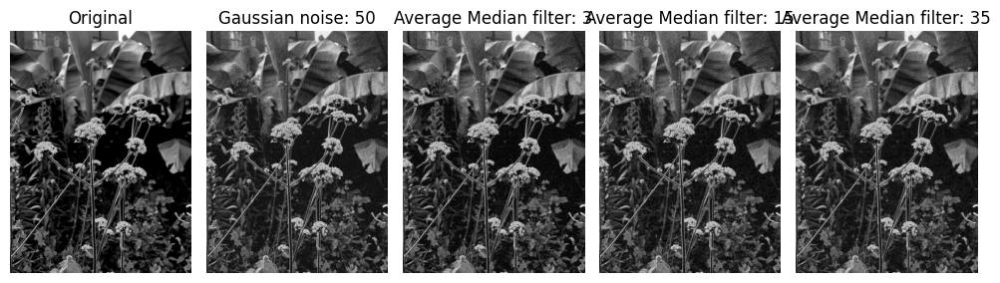


	Showing images with average median filter for Gaussian noise 150:


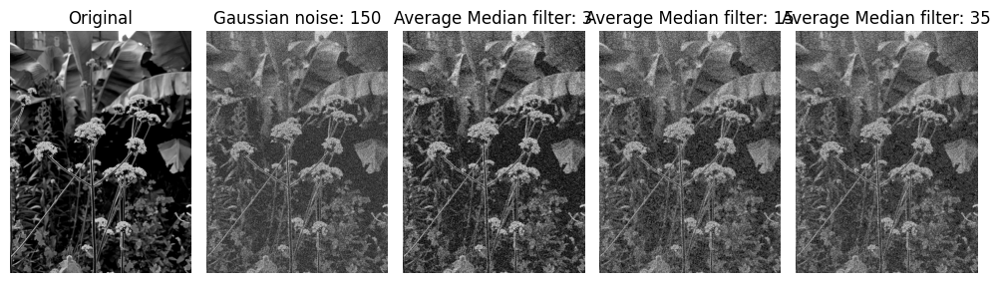


	Showing images with average median filter for Gaussian noise 300:


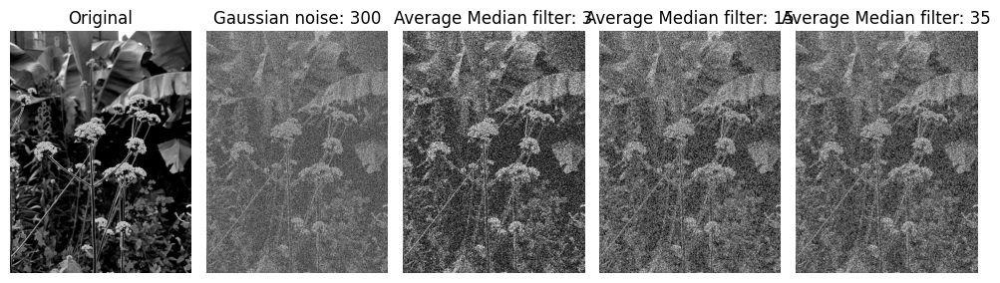

**********************************************************
* Showing images with Average Median filter for image 2: *
**********************************************************


	Showing images with average median filter for Gaussian noise 50:


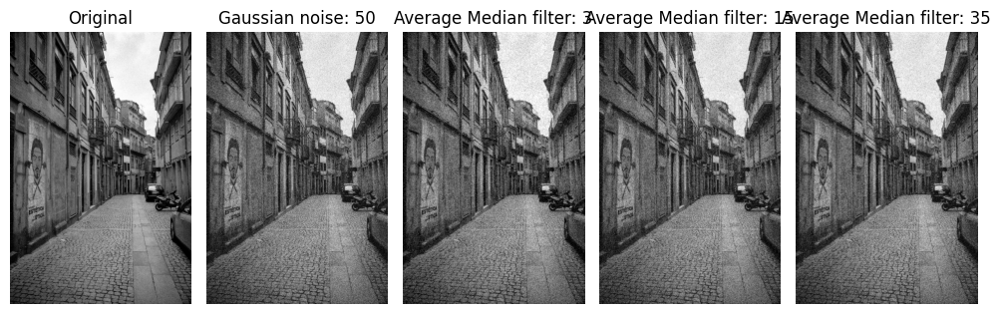


	Showing images with average median filter for Gaussian noise 150:


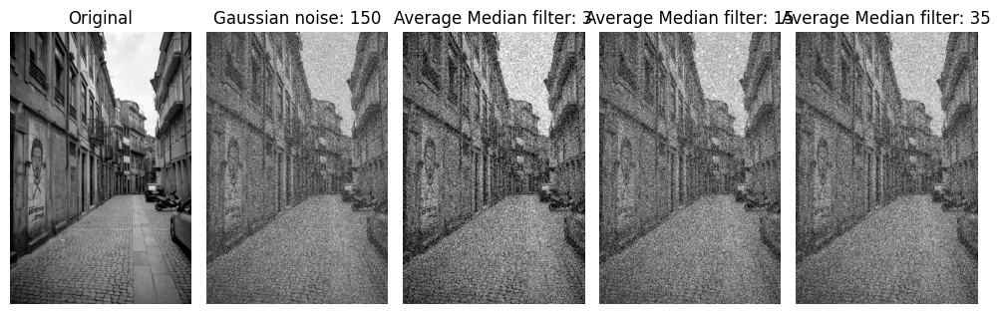


	Showing images with average median filter for Gaussian noise 300:


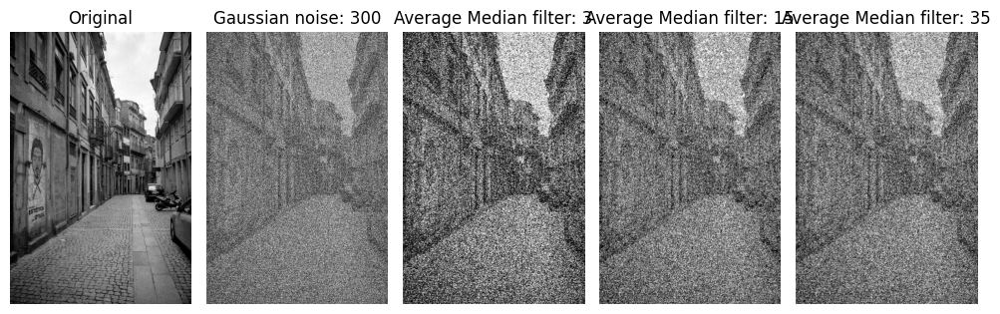

**********************************************************
* Showing images with Average Median filter for image 3: *
**********************************************************


	Showing images with average median filter for Gaussian noise 50:


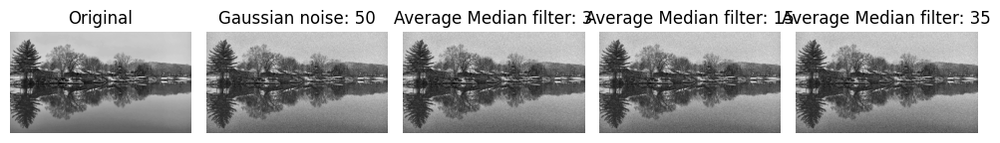


	Showing images with average median filter for Gaussian noise 150:


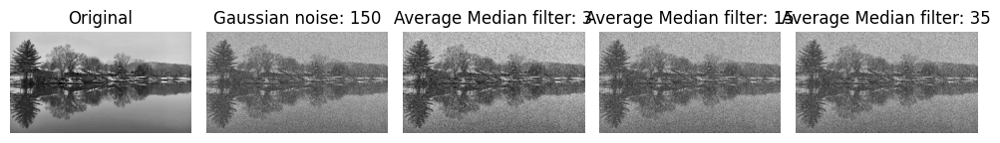


	Showing images with average median filter for Gaussian noise 300:


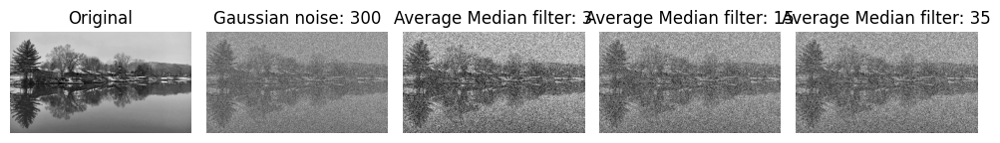

**********************************************************
* Showing images with Average Median filter for image 4: *
**********************************************************


	Showing images with average median filter for Gaussian noise 50:


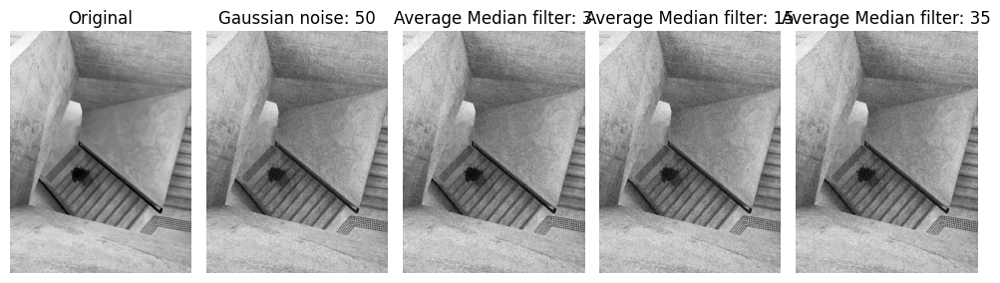


	Showing images with average median filter for Gaussian noise 150:


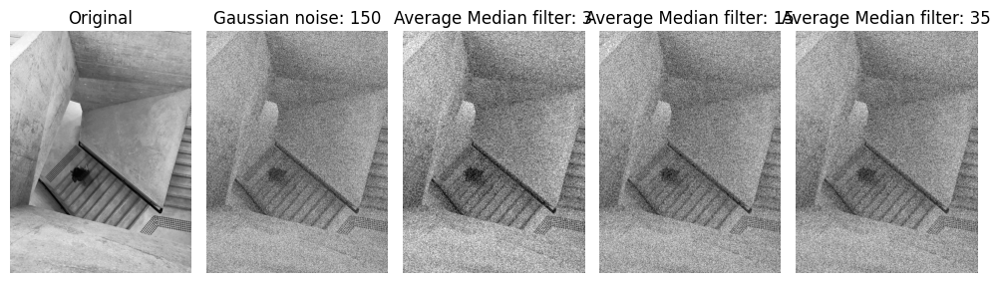


	Showing images with average median filter for Gaussian noise 300:


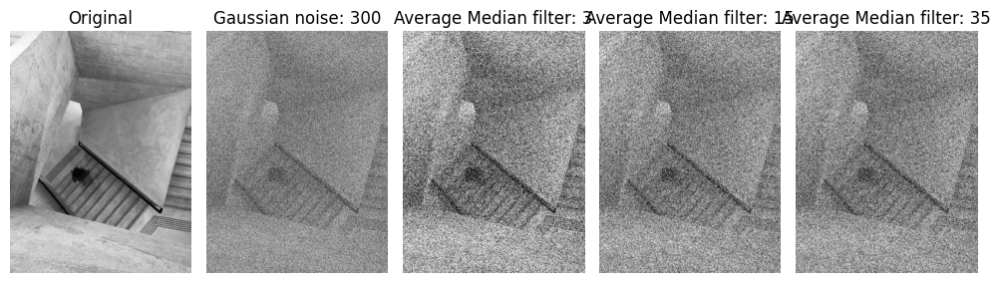

In [41]:



for i in range(len(images)):
    print_with_border(f"Showing images with Average Median filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with average median filter for Gaussian noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['gaussian'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Gaussian noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_AdaptiveMedian_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Average Median filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





In [42]:

#images_with_box_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_AdaptiveMedian_filter_salt_pepper = {i: {n: [] for n in range (len(salt_pepper_values))} for i in range(len(images))}

# time_images_with_box_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

for i in range(len(images)):
    for j in range(len(salt_pepper_values)):
        for k in kernel_sizes:
            # start_time = time.time()
            # images_with_box_filter_gaussian[i][j].append(cv2.blur(images_with_noise[i]['gaussian'][j], (k, k)))
            images_with_AdaptiveMedian_filter_salt_pepper[i][j].append(adaptiveMedianFilter(images_with_noise[i]['salt_pepper'][j], max_kernel_size=k))
            # images_with_AdaptiveMedian_filter_gaussian[i][j].append((time.time() - start_time)*1000)


**********************************************************
* Showing images with Average Median filter for image 1: *
**********************************************************


	Showing images with average median filter for Salt_Pepper noise 0.1:


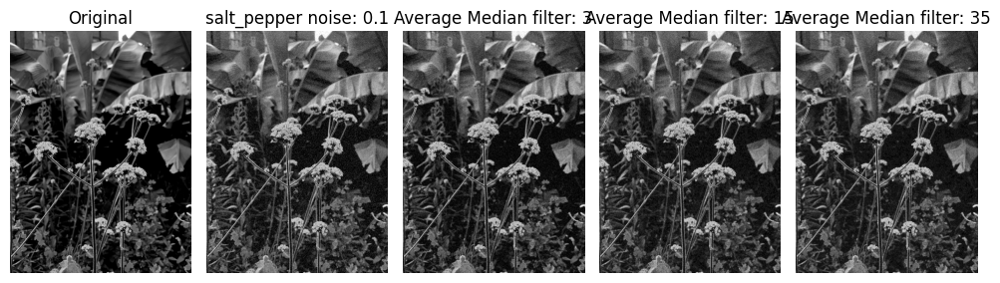


	Showing images with average median filter for Salt_Pepper noise 0.5:


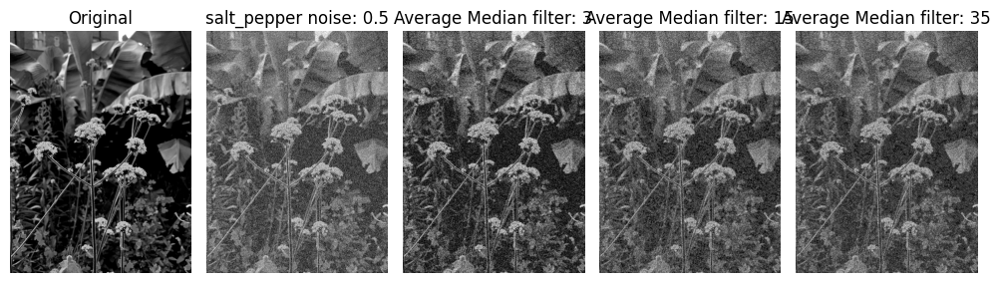


	Showing images with average median filter for Salt_Pepper noise 0.7:


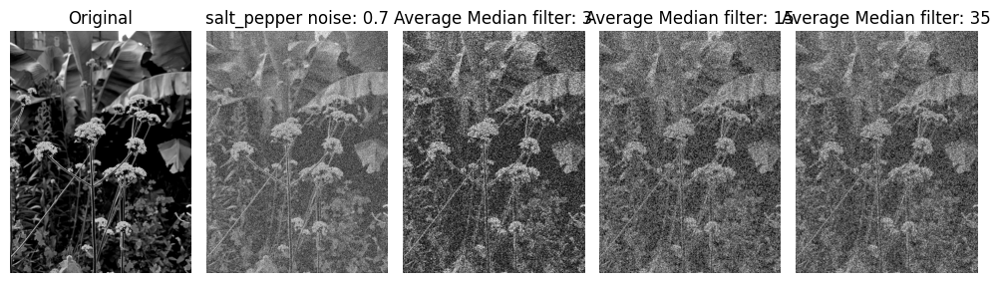

**********************************************************
* Showing images with Average Median filter for image 2: *
**********************************************************


	Showing images with average median filter for Salt_Pepper noise 0.1:


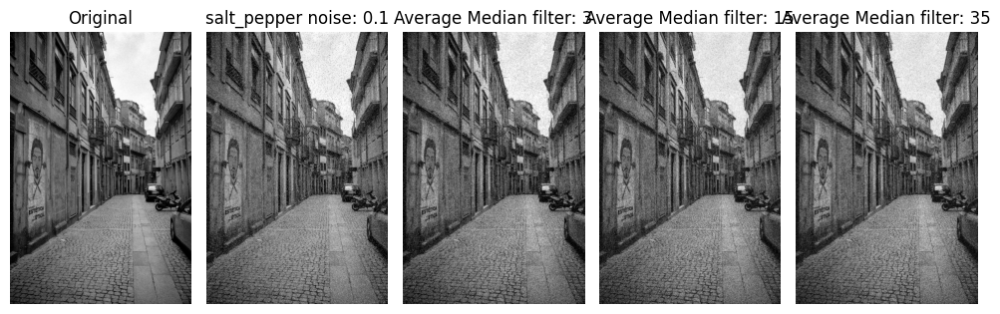


	Showing images with average median filter for Salt_Pepper noise 0.5:


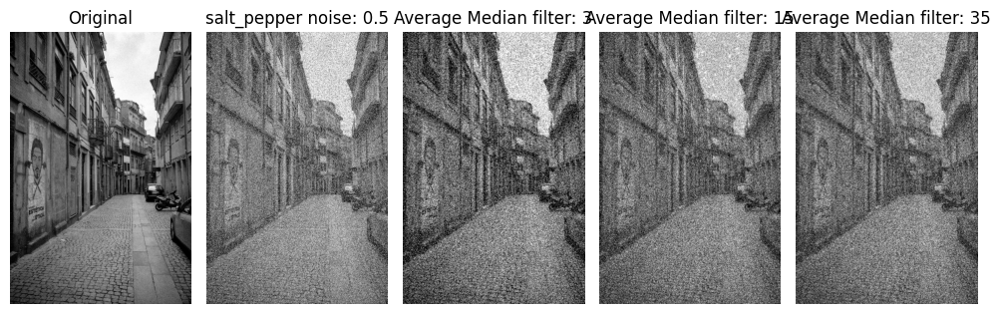


	Showing images with average median filter for Salt_Pepper noise 0.7:


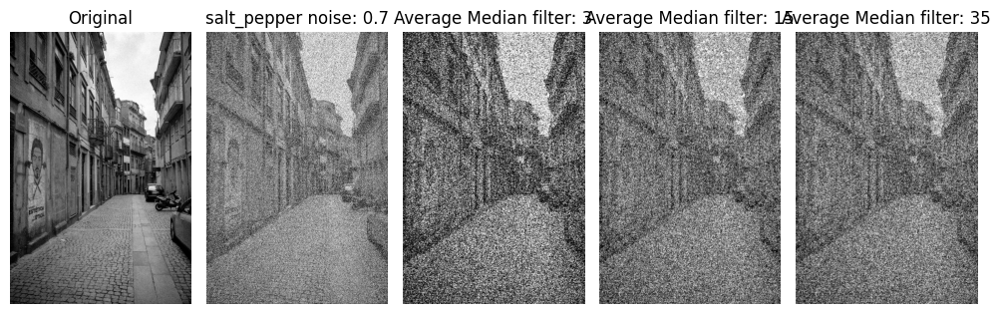

**********************************************************
* Showing images with Average Median filter for image 3: *
**********************************************************


	Showing images with average median filter for Salt_Pepper noise 0.1:


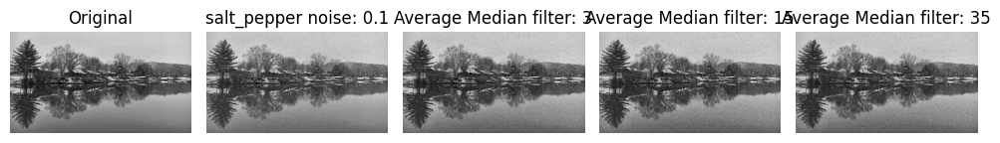


	Showing images with average median filter for Salt_Pepper noise 0.5:


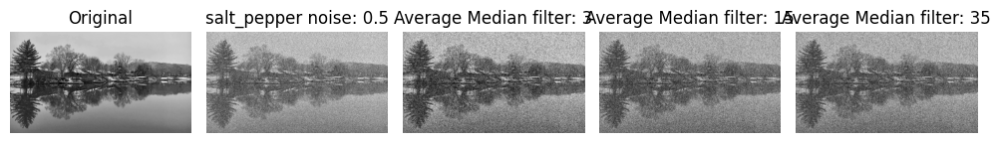


	Showing images with average median filter for Salt_Pepper noise 0.7:


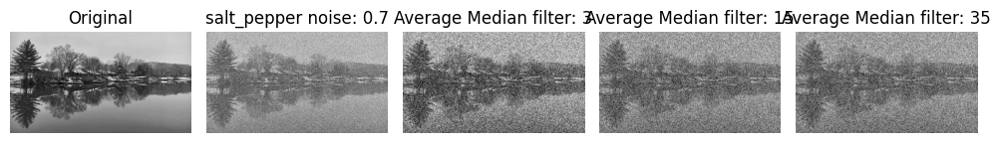

**********************************************************
* Showing images with Average Median filter for image 4: *
**********************************************************


	Showing images with average median filter for Salt_Pepper noise 0.1:


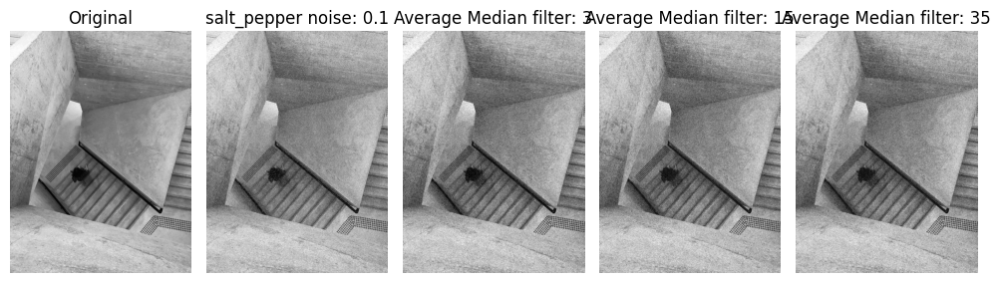


	Showing images with average median filter for Salt_Pepper noise 0.5:


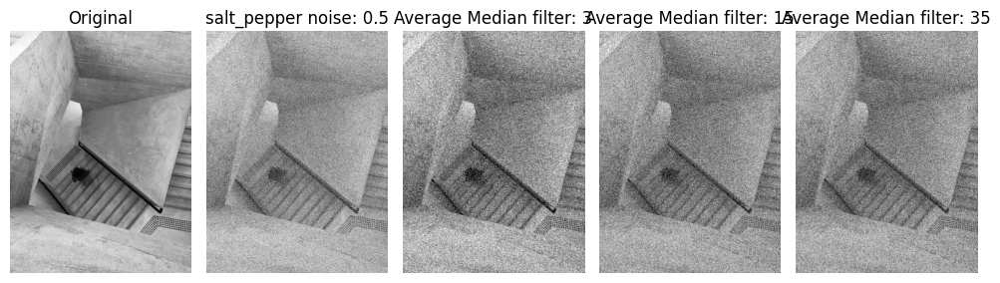


	Showing images with average median filter for Salt_Pepper noise 0.7:


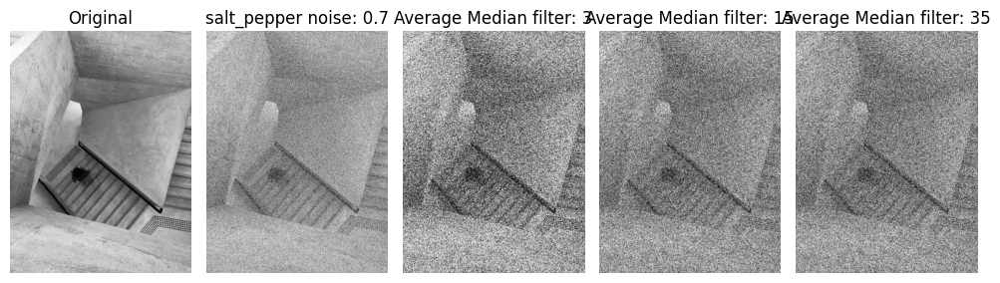

In [43]:



for i in range(len(images)):
    print_with_border(f"Showing images with Average Median filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with average median filter for Salt_Pepper noise {salt_pepper_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['salt_pepper'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'salt_pepper noise: {salt_pepper_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_AdaptiveMedian_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Average Median filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()





### Bilateral Filter

In [10]:

#images_with_median_filter_gaussian = {0:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, 1:{noise1:[k3, k5, k7], noise2:[k3, k5, k7]}, ...}

images_with_Bilateral_filter_gaussian = {i: {n: [] for n in range (len(gaus_values))} for i in range(len(images))}

images_with_Bilateral_filter_gaussian

for i in range(len(images)):
    for j in range(len(gaus_values)):
        for k in kernel_sizes:
            # here kernel as k
            images_with_Bilateral_filter_gaussian[i][j].append(cv2.bilateralFilter(images_with_noise[i]['gaussian'][j],  k,75 , 75 ))
            # bilateralFilter(src, d (can be as kernel size?), sigmaColor, sigmaSpace)




*****************************************************
* Showing images with Bilateral filter for image 1: *
*****************************************************


	Showing images with bilateral filter for Gaussian noise 50:


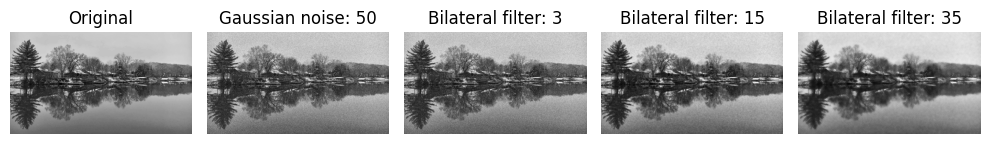


	Showing images with bilateral filter for Gaussian noise 150:


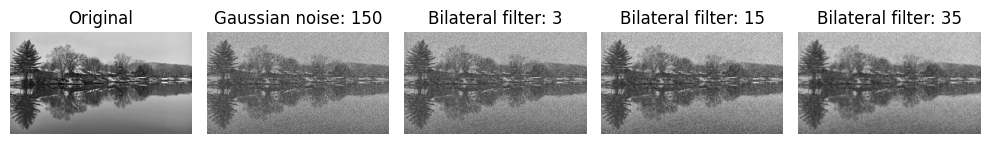


	Showing images with bilateral filter for Gaussian noise 300:


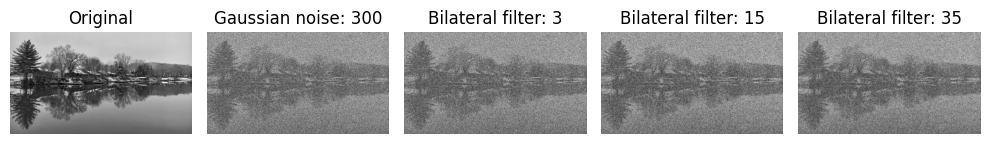

*****************************************************
* Showing images with Bilateral filter for image 2: *
*****************************************************


	Showing images with bilateral filter for Gaussian noise 50:


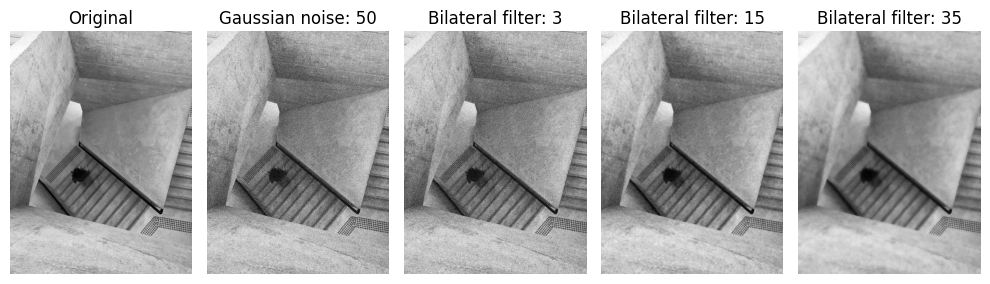


	Showing images with bilateral filter for Gaussian noise 150:


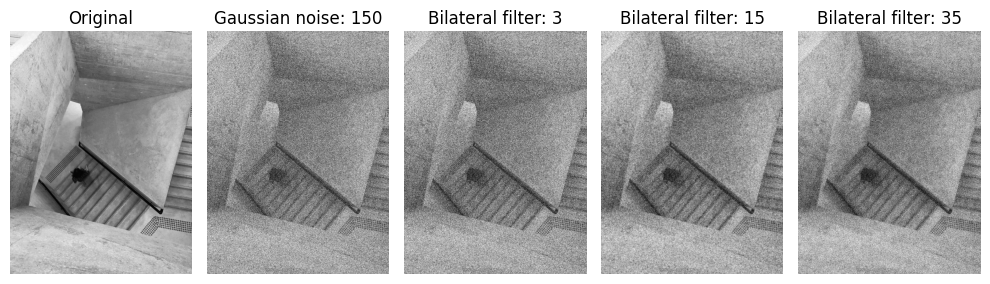


	Showing images with bilateral filter for Gaussian noise 300:


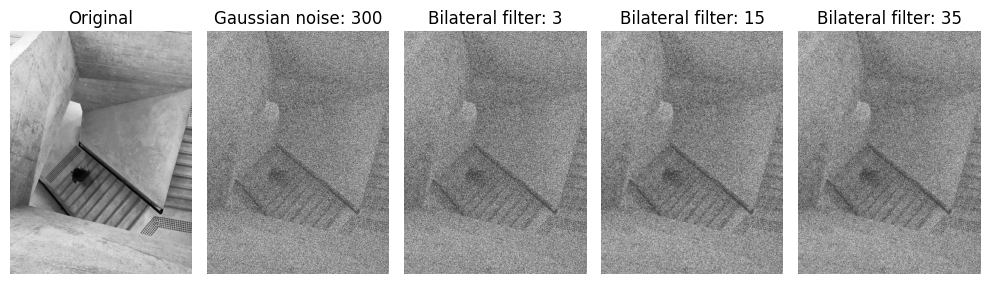

*****************************************************
* Showing images with Bilateral filter for image 3: *
*****************************************************


	Showing images with bilateral filter for Gaussian noise 50:


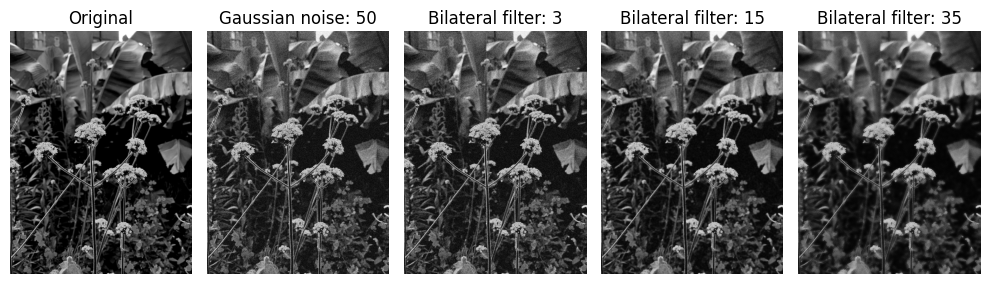


	Showing images with bilateral filter for Gaussian noise 150:


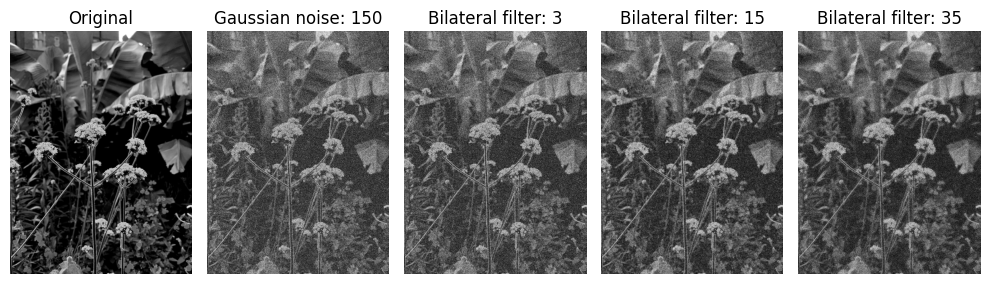


	Showing images with bilateral filter for Gaussian noise 300:


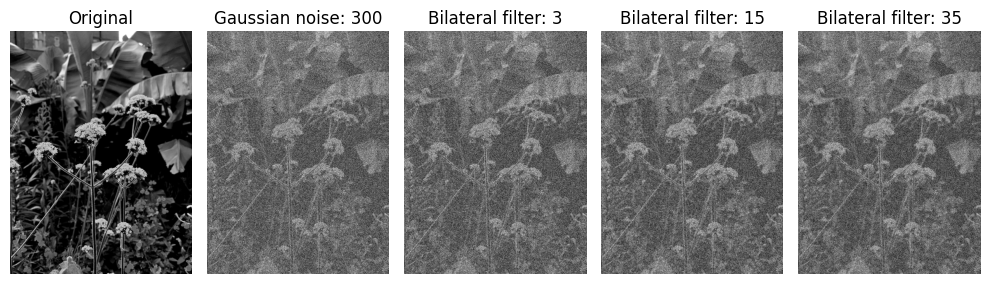

*****************************************************
* Showing images with Bilateral filter for image 4: *
*****************************************************


	Showing images with bilateral filter for Gaussian noise 50:


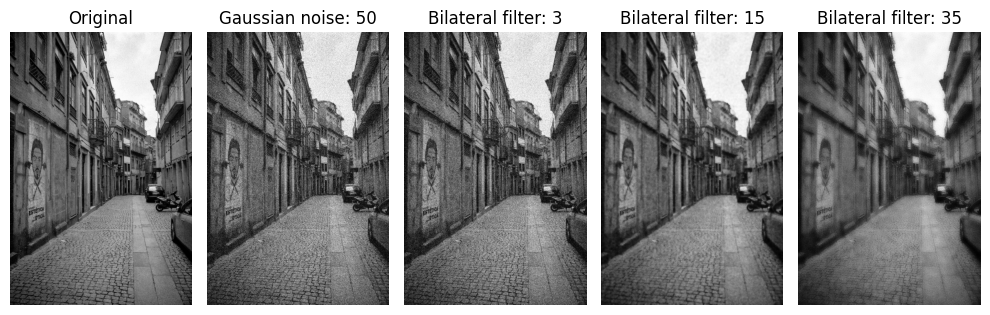


	Showing images with bilateral filter for Gaussian noise 150:


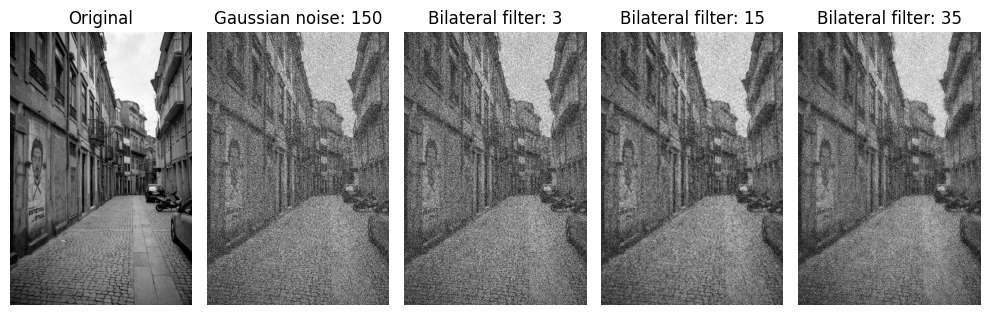


	Showing images with bilateral filter for Gaussian noise 300:


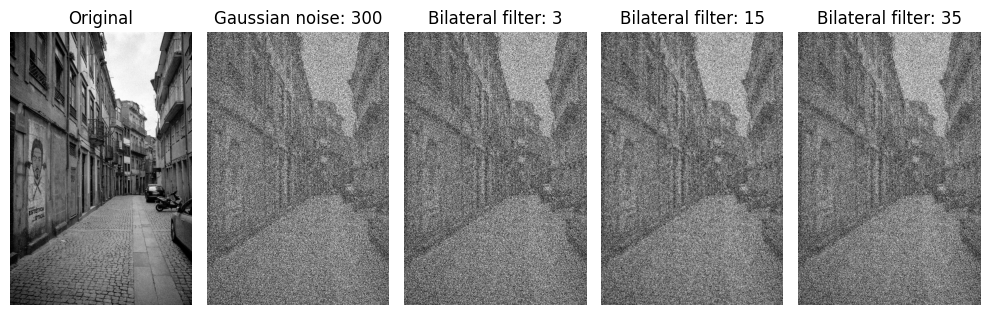

In [11]:



for i in range(len(images)):
    print_with_border(f"Showing images with Bilateral filter for image {i + 1}:")

    for j in range(len(gaus_values)):
        print(f"\n\tShowing images with bilateral filter for Gaussian noise {gaus_values[j]}:")

        fig, axs = plt.subplots(1, len(kernel_sizes)+2, figsize=(10, 10))

        axs[0].imshow(images[i], cmap='gray')
        axs[0].axis('off')
        axs[0].set_title('Original')

        axs[1].imshow(images_with_noise[i]['gaussian'][j], cmap='gray')
        axs[1].axis('off')
        axs[1].set_title(f'Gaussian noise: {gaus_values[j]}')

        for k in range(len(kernel_sizes)):
            axs[k+2].imshow(images_with_Bilateral_filter_gaussian[i][j][k], cmap='gray')
            axs[k+2].axis('off')
            axs[k+2].set_title(f'Bilateral filter: {kernel_sizes[k]}')

        plt.tight_layout()

        plt.show()



